In [2]:
import math
import pandas as pd
import numpy as np
import scipy.stats as stats
from sklearn.metrics import mean_squared_error, mean_absolute_error

import folium
from folium.plugins import MarkerCluster
import seaborn as sn
import matplotlib.pyplot as plt
from matplotlib import gridspec, rcParams
plt.style.use('ggplot')
plt.rcParams.update({'font.size': 16})
plt.rcParams['axes.facecolor'] = 'white'
# plt.rcParams['grid.color'] = 'white'
plt.rcParams['figure.figsize'] = (20,8)
plt.rcParams['savefig.dpi'] = 300
colors = ['black', 'slategrey', 'm','tab:orange', 'yellowgreen', 'violet', 'thistle', 'plum']
alphas = [1, .5, 1, 1, 1]
s = 5

from cleaning import *
from eda import *
from HypeTest import *
from nlp import *
from regression_model import *
from classification_model import *
from broken_stick_fit import *


import warnings
warnings.filterwarnings('ignore')

# CLEANING

### read in raw data & clean with cleaning class from cleaning.py

In [2]:
JanJun2015 = pd.read_csv('../data/JanJun2015.csv', low_memory=False)
JulDec2015 = pd.read_csv('../data/JulDec2015.csv', low_memory=False)
JanJun2016 = pd.read_csv('../data/JanJun2016.csv', low_memory=False)
JulDec2016 = pd.read_csv('../data/JulDec2016.csv', low_memory=False) 
JanJun2017 = pd.read_csv('../data/JanJun2017.csv', low_memory=False)
JulDec2017 = pd.read_csv('../data/JulDec2017.csv', low_memory=False)
JanJun2018 = pd.read_csv('../data/JanJun2018.csv', low_memory=False)
JulDec2018 = pd.read_csv('../data/JulDec2018.csv', low_memory=False)
JanJun2019 = pd.read_csv('../data/JanJun2019.csv', low_memory=False)
JulDec2019 = pd.read_csv('../data/JulDec2019.csv', low_memory=False)
JanJun2020 = pd.read_csv('../data/JanJun2020.csv', low_memory=False)
JulDec2020 = pd.read_csv('../data/JulDec2020.csv', low_memory=False)

# combine datasets
file_list = [JanJun2015, JulDec2015, JanJun2016, JulDec2016, JanJun2017, 
             JulDec2017, JanJun2018, JulDec2018, JanJun2019, JulDec2019]
orig_df = pd.concat(file_list)

covid_list = [JanJun2020, JulDec2020]
covid_df = pd.concat(covid_list)

all_the_data_list = [JanJun2015, JulDec2015, JanJun2016, JulDec2016, JanJun2017, 
             JulDec2017, JanJun2018, JulDec2018, JanJun2019, JulDec2019, JanJun2020, JulDec2020]
all_the_data_df = pd.concat(all_the_data_list)

# split data to protect against leakage
train_df, quick_df, slow_df, holdout_df = SplitData(orig_df).train_quick_slow_holdout()
train_df.to_csv('../data/train_df.csv')
quick_df.to_csv('../data/quick_df.csv')
slow_df.to_csv('../data/slow_df.csv')
holdout_df.to_csv('../data/holdout_df.csv')

covid_train_df, covid_quick_df, covid_slow_df, covid_holdout_df = SplitData(covid_df).train_quick_slow_holdout()
covid_train_df.to_csv('../data/covid_train_df.csv')
covid_quick_df.to_csv('../data/covid_quick_df.csv')
covid_slow_df.to_csv('../data/covid_slow_df.csv')
covid_holdout_df.to_csv('../data/covid_holdout_df.csv')

all_the_data_train_df, all_the_data_quick_df, all_the_data_slow_df, all_the_data_holdout_df = SplitData(all_the_data_df).train_quick_slow_holdout()
all_the_data_train_df.to_csv('../data/all_the_data_train_df.csv')
all_the_data_quick_df.to_csv('../data/all_the_data_quick_df.csv')
all_the_data_slow_df.to_csv('../data/all_the_data_slow_df.csv')
all_the_data_holdout_df.to_csv('../data/all_the_data_holdout_df.csv')

# clean data sets separately
train, train_data_loss_dict = DataFeatures(train_df).ready_data()
quick, quick_data_loss_dict = DataFeatures(quick_df).ready_data()
slow, slow_data_loss_dict = DataFeatures(slow_df).ready_data()
holdout, holdout_data_loss_dict = DataFeatures(holdout_df).ready_data()

covid_train, covid_train_data_loss_dict = DataFeatures(covid_train_df).ready_data()
covid_quick, covid_quick_data_loss_dict = DataFeatures(covid_quick_df).ready_data()
covid_slow, covid_slow_data_loss_dict = DataFeatures(covid_slow_df).ready_data()
covid_holdout, covid_holdout_data_loss_dict = DataFeatures(covid_holdout_df).ready_data()

all_the_data_train, all_the_data_train_data_loss_dict = DataFeatures(all_the_data_train_df).ready_data()
all_the_data_quick, all_the_data_quick_data_loss_dict = DataFeatures(all_the_data_quick_df).ready_data()
all_the_data_slow, all_the_data_slow_data_loss_dict = DataFeatures(all_the_data_slow_df).ready_data()
all_the_data_holdout, all_the_data_holdout_data_loss_dict = DataFeatures(all_the_data_holdout_df).ready_data()

#### OLS for EM imputation (not used in model)

0.0009144350097974874

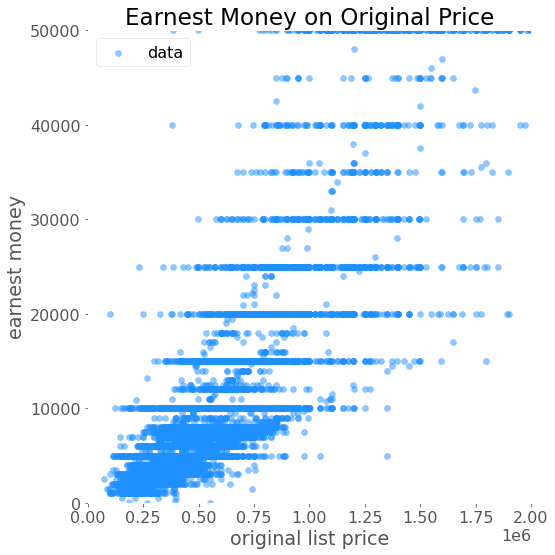

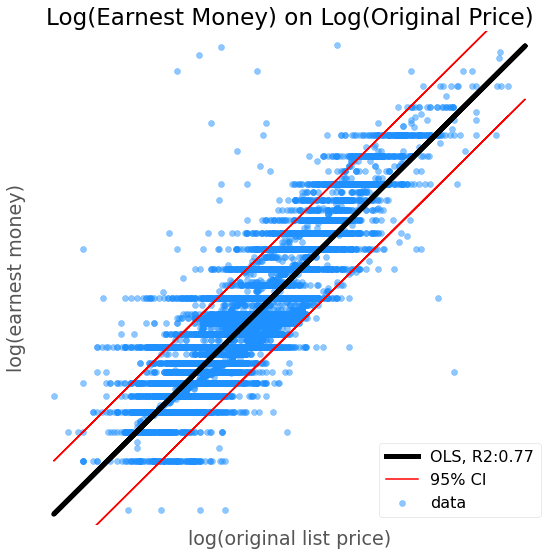

In [33]:
# log transform on predictor and response
b0 = -9.961
b1 = 1.435
rsq = 0.773

import statsmodels.api as sm
from statsmodels.sandbox.regression.predstd import wls_prediction_std

train = pd.read_csv('../data/train_df.csv')
holdout = pd.read_csv('../data/holdout.csv')

df= train[['Contract Min Earnest', 'Original List Price']]

temp = df[df['Contract Min Earnest']>0][['Original List Price', 'Contract Min Earnest']]
temp['y'] = np.log(temp['Contract Min Earnest'])
temp['x'] = np.log(temp['Original List Price'])
lmod = smf.ols('y~x', data=temp).fit()
betas = lmod.params
lmod.summary()
yhat = [val if val>0 else(np.e**betas[0])*(new_x**betas[1]) 
            for val, new_x in zip(df['Contract Min Earnest'], 
            df['Original List Price'])]

fig, ax = plt.subplots(figsize=(8,8))
ax.scatter(np.e**temp.x, np.e**temp.y, label='data', 
           color='dodgerblue', alpha=.5)
ax.set_xlabel('original list price')
ax.set_ylabel('earnest money')
ax.set_ylim(0,50000)
ax.set_xlim(0,2000000)
ax.set_title('Earnest Money on Original Price')
ax.legend();
fig.tight_layout()
fig.savefig('../images/em_on_price.png')
          
prstd, iv_l, iv_u = wls_prediction_std(lmod)

fig, ax = plt.subplots(figsize=(8,8))
ax.scatter(temp.x, temp.y, label='data', color='dodgerblue', alpha=.5)
ax.set_xlabel('log(original list price)')
ax.set_ylabel('log(earnest money)')
ax.set_ylim(6,13)
ax.plot(temp.x, lmod.fittedvalues, 'k', linewidth=5,
        label=f'OLS, R2:{lmod.rsquared:2.2f}')
ax.plot(temp.x, iv_u,'r', label='95% CI')
ax.plot(temp.x, iv_l, 'r')
ax.set_title('Log(Earnest Money) on Log(Original Price)')
ax.set_yticks([])
ax.set_xticks([])
ax.legend();
fig.tight_layout()
fig.savefig('../images/ols_em_on_price.png')

1-22944/22965

### data lists by type

In [ ]:
identity = ['Listing Id']

numeric = ['dtp', 'dtc', 'dom', 'ratio', 'fin_sqft',
           'inventory', 'good_agent', 'n_baths', 'n_beds', 
           'n_fireplaces','n_photos', 'orig_price', 
           'close_price', 'lot_sqft','walkscore', 
           'psf', 'em', 'ba_comp', 'garage_spaces', 
           'year_built']

boolean = ['quick', 'back_on_market', 'is_vacant', 
           'has_fireplace', 'has_bsmt', 'one_story', 
           'is_realtor', 'offer_var_comp', 'has_virtual_tour', 
           'has_showing_instr', 'with_cash','is_corp_owner', 
           'is_warm']

categoric = ['financing', 'ownership', 'garage_size', 
             'period', 'photo'] 
             
binned = ['garage_zero', 'garage_one', 'garage_two',
          'period_turn', 'period_midmod', 'period_modern', 
          'photo_small', 'photo_medium', 'photo_large']

text = ['private', 'public', 'showing_instructions', 
        'all', 'low_all']

geographic = ['lat', 'long', 'lat', 'long', 'zip', 
              'Street Name', 'Street Number', 'str_suffix']

datetime = ['lcd_day_of_month', 'lcd_day_of_week', 'lcd_month', 
            'lcd_year', 'lcd_day_mo_year','lcd_mo_year', 
            'pcd_day_of_month', 'pcd_day_of_week', 'pcd_month', 
            'pcd_year', 'pcd_day_mo_year', 'pcd_mo_year',
            'cd_day_of_month', 'cd_day_of_week', 'cd_month', 
            'cd_year', 'cd_day_mo_year', 'cd_mo_year']

school = ['Elementary School', 'Middle Or Junior School', 
          'High School']

### sparse columns >10% null: 81 of 401 columns ~ 20%

In [3]:
all_df_train = pd.read_csv('../data/all_the_data_train.csv')
all_df_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

ten_perent_of_data = all_df.shape[0]*.10
nan_per_col = all_df.isna().sum().sort_values()
perc_w_atleast_90_perc_data = (nan_per_col<ten_perent_of_data).sum()/401
perc_w_atleast_90_perc_data, perc_w_atleast_90_perc_data*401

(0.19950124688279303, 80.0)

In [4]:
train = pd.read_csv('../data/train.csv')
quick = pd.read_csv('../data/quick.csv')
slow = pd.read_csv('../data/slow.csv')
holdout = pd.read_csv('../data/holdout.csv')

covid_train = pd.read_csv('../data/covid_train.csv')
covid_quick = pd.read_csv('../data/covid_quick.csv')
covid_slow = pd.read_csv('../data/covid_slow.csv')
covid_holdout = pd.read_csv('../data/covid_holdout.csv')

all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_quick = pd.read_csv('../data/all_the_data_quick.csv')
all_the_data_slow = pd.read_csv('../data/all_the_data_slow.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')

### target data loss dictionary by features

In [5]:
d1 = all_the_data_train_data_loss_dict
d2 = all_the_data_holdout_data_loss_dict
d = combine_dict(d1,d2)
df = data_loss_dict(d)
df

,preserved data,loss,% loss
orig,34519.0,0.0,0.000000
lat,34515.0,4.0,0.011588
long,34515.0,0.0,0.000000
n_baths,34486.0,29.0,0.084012
dtc > 0,34435.0,51.0,0.147745
new_build,32828.0,1607.0,4.655407
ratio 99,32503.0,325.0,0.941510
dtp 180,32135.0,368.0,1.066080
dtc 77,31837.0,298.0,0.863293
TRID,31799.0,38.0,0.110084


### target data loss visualization for imposing maximums on target values

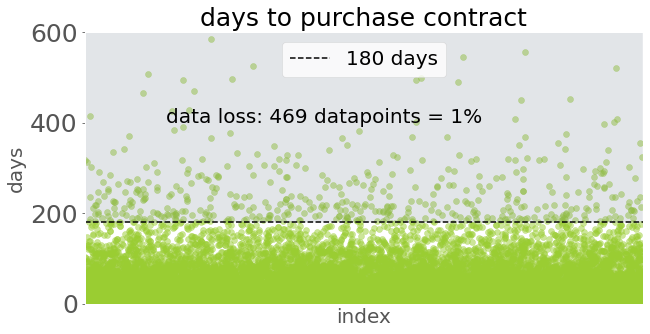

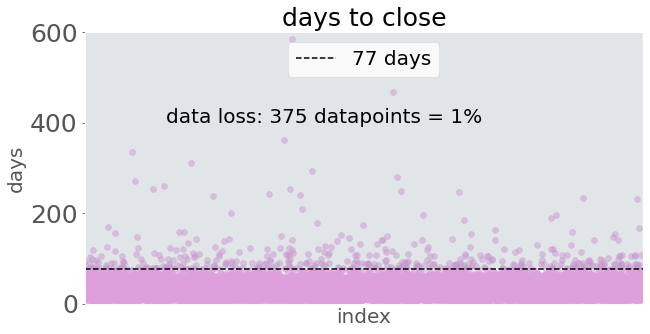

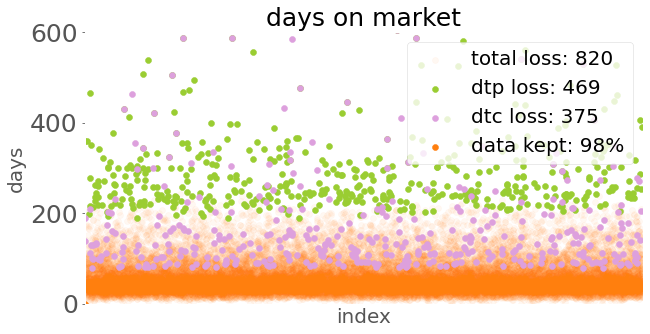

In [5]:
all_df_train_df = pd.read_csv('../data/all_the_data_train_df.csv')
all_df_holdout_df = pd.read_csv('../data/all_the_data_holdout_df.csv')
all_df = pd.concat([all_df_train_df, all_df_holdout_df])
fig, ax = plt.subplots(figsize=(10,5))
data_loss_index(ax, all_df, 'dtp', 180, 'yellowgreen', 'days to purchase contract')
ax.set_xticks([])
fig.savefig('../images/dtp_data_loss.png')

fig, ax = plt.subplots(figsize=(10,5))
data_loss_index(ax, all_df, 'dtc', 77, 'plum', 'days to close')
ax.set_xticks([])
fig.savefig('../images/dtc_data_loss.png')
    
fig, ax = plt.subplots(figsize=(10,5))
data_loss_target(ax, all_df)
ax.set_xticks([])
fig.savefig('../images/dom_data_loss.png')

### winsorize

In [8]:
all_df_train_df = pd.read_csv('../data/all_the_data_train_df.csv')
all_df_holdout_df = pd.read_csv('../data/all_the_data_holdout_df.csv')
all_df = pd.concat([all_df_train_df, all_df_holdout_df])
all_df.shape

class Winsorize():
    def __init__(self, df, col_list):
        self.df = df
        self.col_list = col_list
    
    def find_outlier_cut_off(self, arr):
        q1 = np.percentile(arr,25)
        q3 = np.percentile(arr,75)
        iqr = q3 - q1
        cut_off = q3 + 1.5*iqr
        return cut_off

    def find_count(self, arr, cut_off):
        return  len(arr[arr>=cut_off])
    
    def find_perc(self, arr, cut_off):
        return len(arr[arr>cut_off])/self.df.shape[0]

    def out_df(self):
        d = {}
        for col in self.col_list:
            cut_off = self.find_outlier_cut_off(self.df[col])
            cnt = self.find_count(self.df[col], cut_off)
            pct = (self.find_perc(self.df[col], cut_off))*100
            pct = round(pct,2)
            d[col] = (cut_off, cnt, pct)
        return pd.DataFrame.from_dict(d, orient='index', columns=['cut_off', 'count', 'percent'])#.set_index(['cut_off', 'count', 'percent'])
    
winsor = Winsorize(all_df, ['dom', 'dtp', 'dtc']).out_df()
winsor

,cut_off,count,percent
dom,121.5,2649,7.67
dtp,74.0,3282,9.30
dtc,58.5,1342,3.89


# EDA

### descriptive statistics for cleaned data

In [9]:
all_df_train = pd.read_csv('../data/all_the_data_train.csv')
all_df_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])
all_df[['dom', 'dtp', 'dtc']].describe().T

,count,mean,std,min,25%,50%,75%,max
dom,31799.0,54.448819,33.079581,3.0,34.0,44.0,64.0,244.0
dtp,31799.0,22.091638,30.346489,0.0,4.0,8.0,28.0,180.0
dtc,31799.0,32.357181,11.246252,1.0,26.0,32.0,38.0,77.0


## Central Tendencies
### Mean

#### not ready for prime time decomp of dtp and dtc

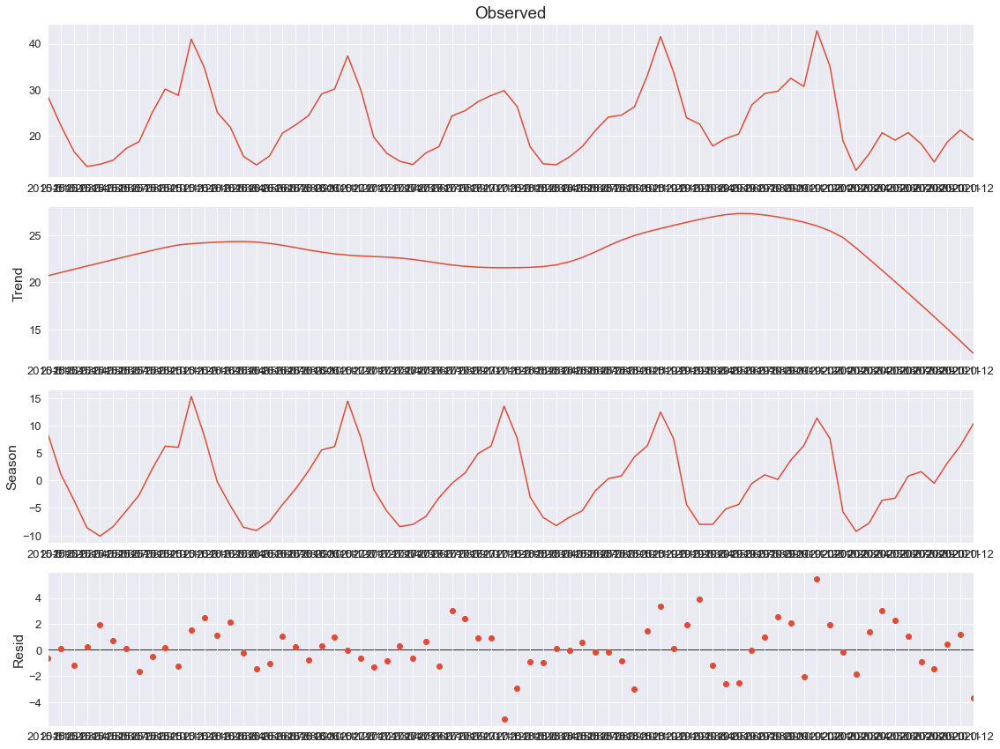

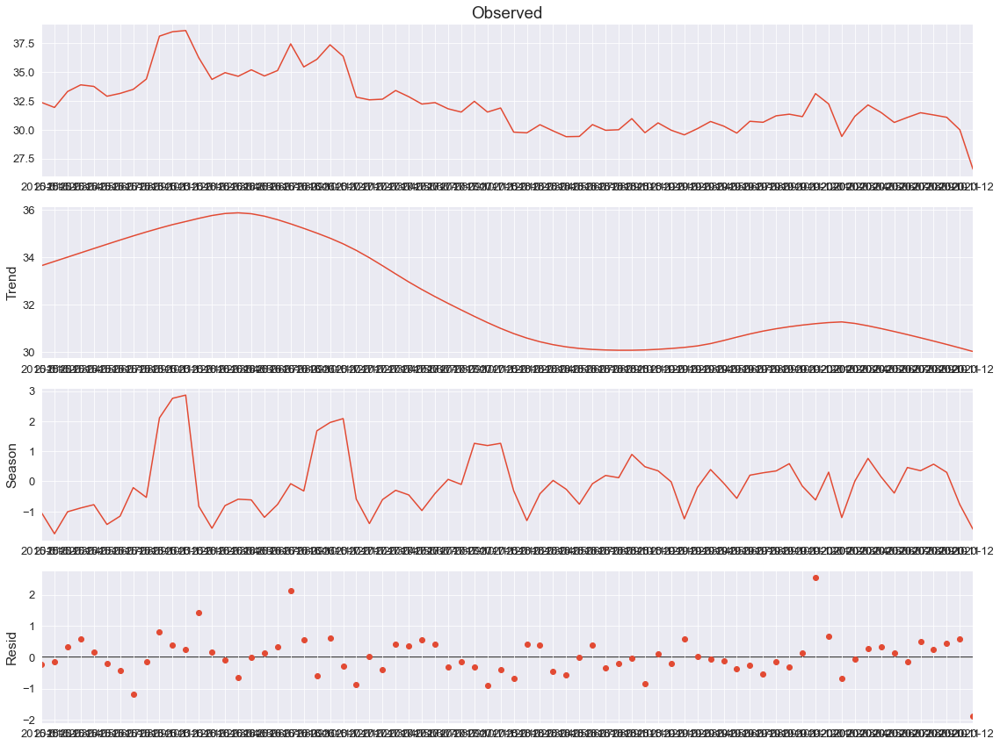

In [149]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
sns.set_style('darkgrid')
plt.rc('figure',figsize=(16,12))
plt.rc('font',size=13)
from statsmodels.tsa.seasonal import STL

all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

dtp_ts = STL(all_df[['dtp', 'pcd_mo_year']].groupby('pcd_mo_year').mean(), seasonal=13, period=12)
res = dtp_ts.fit()
fig = res.plot()

dtp_ts1 = STL(all_df[['dtc', 'pcd_mo_year']].groupby('pcd_mo_year').mean(), seasonal=13, period=12)
res = dtp_ts1.fit()
fig = res.plot()

#### time series: monthly mean: DTP:seaonality, DTC:trend

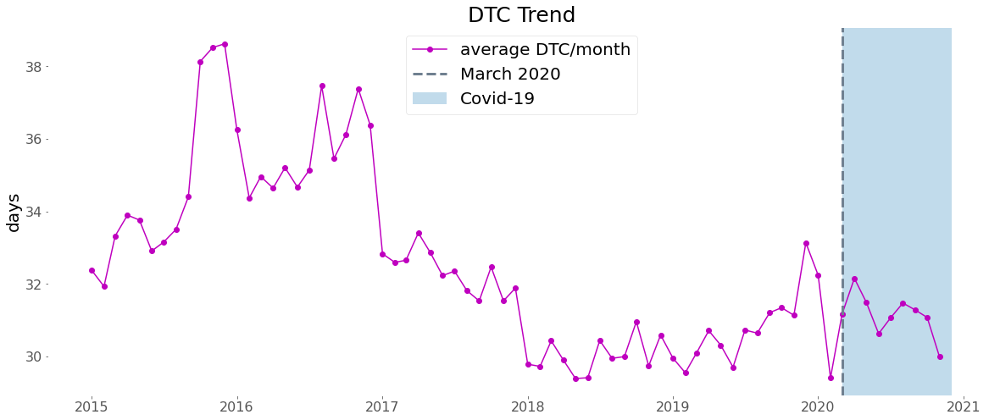

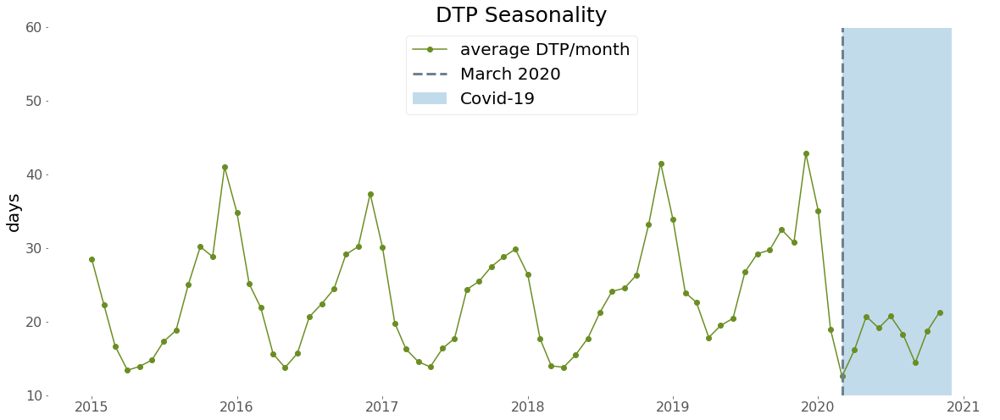

In [11]:
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

active = pd.read_csv('../data/active.csv')
new = pd.read_csv('../data/new.csv')
pending = pd.read_csv('../data/pending.csv')
closed = pd.read_csv('../data/closed.csv')
showings = pd.read_csv('../data/showings.csv')

active = convert_to_date(active, 'date', 'active')
new = convert_to_date(new, 'date', 'new')
pending = convert_to_date(pending, 'date', 'pending')
closed = convert_to_date(closed, 'date', 'closed')
showings = convert_to_date(showings, 'date', 'showings')
activity = active.join(new).join(pending).join(closed).join(showings)

df = all_df[['dtp', 'dtc', 'pcd_mo_year', 'pcd_month']]
df = df.groupby('pcd_mo_year').mean()
activity = df.join(activity)


# DTC trend function
def sine(x):
    return 3.12*np.sin((np.pi/30)*(x+1.5))+32.36
activity['sine'] = [sine(x) for x in np.arange(72)]

# DTC trend
fig, ax = plt.subplots(figsize=(20,8))
ax.plot(activity.index[:-1], activity.dtc[:-1], label = 'average DTC/month', color='m', marker='o')
ax.axvline(x='2020-03-01', linestyle='--', label = 'March 2020', lw=3, color = 'slategrey')
ax.axvspan('2020-03', '2020-12', alpha=.3, label = 'Covid-19')
ax.set_ylabel('days', fontsize=20, color = 'k')

# trend
ax.set_title('DTC Trend', fontsize=25)
ax.legend(fontsize=20, facecolor='white', loc='upper center');
fig.savefig('../images/dtc_trend_ts.png') # save DTC

# # sine feature
# ax.set_title('DTC Trend Feature', fontsize=25)
# ax.plot(activity.index[:-1], activity.sine[:-1], color='k', linestyle=':', linewidth=3,
#        label = 'sine estimation')
# ax.legend(fontsize=20, facecolor='white', loc='upper center');
# fig.savefig('../images/dtc_sine_ts.png') # save DTC

# # TRID
# ax.set_title('DTC TRID', fontsize=25)
# ax.plot(activity.index[:-1], activity.sine[:-1], color='k', linestyle=':', linewidth=3,
#        label = 'sine estimation')
# ax.axvline(x='2015-10-01', linestyle=':', linewidth=10, color='r', label='TRID: Oct 2015')
# ax.legend(fontsize=20, facecolor='white', loc='upper center');
# fig.savefig('../images/dtc_TRID_ts.png') # save DTC

 

# Start for either
fig, ax = plt.subplots(figsize=(20,8))
ax.plot(activity.index[:-1], activity.dtp[:-1], 
        label = 'average DTP/month', color = 'olivedrab', 
        marker='o')
ax.axvspan('2020-03', '2020-12', alpha=.3, label = 'Covid-19')
ax.set_ylim(10,60)
ax.set_ylabel('days', fontsize=20, color = 'k')

# # DTP and DTC time series
# ax.plot(activity.index[:-1], activity.dtc[:-1], label = 'average DTC/month', color='m', marker='o')
# ax.axvline(x='2020-03-01', linestyle='--', label = 'March 2020', lw=3, color = 'slategrey')
# ax.set_title('Average DTP & DTC per month', fontsize=25)
# ax.legend(fontsize=20, facecolor='white', loc='upper center');
# fig.savefig('../images/targets_ts.png')

# just DTP
ax.axvline(x='2020-03-01', linestyle='--', label = 'March 2020', lw=3, color = 'slategrey')
ax.set_title('DTP Seasonality', fontsize=25)
ax.legend(fontsize=20, facecolor='white', loc='upper center');
fig.savefig('../images/dtp_season_ts.png') # save just DTP

# WOW! DTP
# ax.axvline(x='2020-03-01', linestyle='--', label = 'March 2020', lw=3, color = 'slategrey')
# ax.set_title('Average DTP per month', fontsize=25)
# ax.text('2020-04-01', 22, 'WOW!', color='m', fontsize=35);
# ax.legend(fontsize=20, facecolor='white', loc='upper center');
# fig.savefig('../images/dtp_season_ts_wow.png') # save just DTP

# ____________________________________________________________________________DON'T USE
### OLD EYEBALL BROKEN STICK
# DTP seasonality function
# activity['seasonality'] = [br_stick(x, 5) for x in activity.pcd_month]
# broken stick feature
# ax.axvline(x='2020-03-01', linestyle='--', label = 'March 2020', lw=3, color = 'slategrey')
# ax.plot(activity.index[:-1], activity.seasonality[:-1], color='k', linestyle=':', linewidth=3,
#        label = 'broken stick estimation')
# ax.set_title('DTP Seasonality Feature', fontsize=25)
# ax.legend(fontsize=20, facecolor='white', loc='upper center');
# fig.savefig('../images/broken_stick_ts.png') # save broken stick


#### all the data to see if the covid data is obviously different

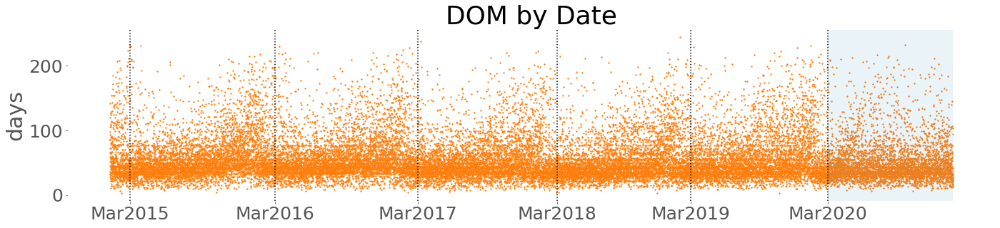

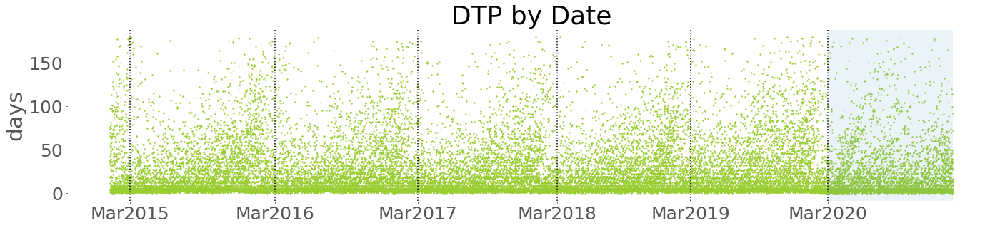

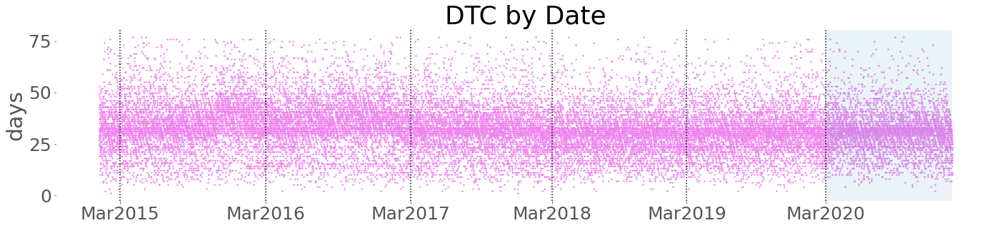

In [50]:
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

# DOM
# chronological data
df = all_df[['pcd_day_mo_year', 'dom']].sort_values(by='pcd_day_mo_year').reset_index()

# dict of cut off points for March of each year
d = {}
for mo, dt in zip(['Mar2015', 'Mar2016', 'Mar2017', 'Mar2018', 'Mar2019', 'Mar2020'],['2015-03-01','2016-03-01','2017-03-01','2018-03-01','2019-03-01','2020-03-01']):
    d[mo]=df[df.pcd_day_mo_year<dt].shape[0]
list(d.values())
# plot data over time 
fig, ax = plt.subplots(figsize=(20,5))
ax.scatter(df.index, df.dom, s=3, color='tab:orange')
ax.set_xticks(list(d.values()))
ax.set_xticklabels(list(d.keys()))
ax.set_ylabel('days')
ax.axvspan(27076,31800, alpha=.1)
for k, v in d.items():
    ax.axvline(x=v, linestyle=':', color='k')
ax.set_title('DOM by Date');
fig.tight_layout()
fig.savefig('../images/dom_by_date.png')

# DTP
# chronological data
df = all_df[['pcd_day_mo_year', 'dtp']].sort_values(by='pcd_day_mo_year').reset_index()

# dict of cut off points for March of each year
d = {}
for mo, dt in zip(['Mar2015', 'Mar2016', 'Mar2017', 'Mar2018', 'Mar2019', 'Mar2020'],['2015-03-01','2016-03-01','2017-03-01','2018-03-01','2019-03-01','2020-03-01']):
    d[mo]=df[df.pcd_day_mo_year<dt].shape[0]
list(d.values())
# plot data over time 
fig, ax = plt.subplots(figsize=(20,5))
ax.scatter(df.index, df.dtp, s=3, color='yellowgreen')
ax.set_xticks(list(d.values()))
ax.set_xticklabels(list(d.keys()))
ax.set_ylabel('days')
ax.axvspan(27076,31800, alpha=.1)
for k, v in d.items():
    ax.axvline(x=v, linestyle=':', color='k')
ax.set_title('DTP by Date');
fig.tight_layout()
fig.savefig('../images/dtp_by_date.png')

# DTC
# chronological data
df = all_df[['pcd_day_mo_year', 'dtc']].sort_values(by='pcd_day_mo_year').reset_index()

# dict of cut off points for March of each year
d = {}
for mo, dt in zip(['Mar2015', 'Mar2016', 'Mar2017', 'Mar2018', 'Mar2019', 'Mar2020'],['2015-03-01','2016-03-01','2017-03-01','2018-03-01','2019-03-01','2020-03-01']):
    d[mo]=df[df.pcd_day_mo_year<dt].shape[0]
list(d.values())
# plot data over time 
fig, ax = plt.subplots(figsize=(20,5))
ax.scatter(df.index, df.dtc, s=3, color='violet')
ax.set_xticks(list(d.values()))
ax.set_xticklabels(list(d.keys()))
ax.set_ylabel('days')
ax.axvspan(27076,31800, alpha=.1)
for k, v in d.items():
    ax.axvline(x=v, linestyle=':', color='k')
ax.set_title('DTC by Date');
fig.tight_layout()
fig.savefig('../images/dtc_by_date.png')

### supply and demand

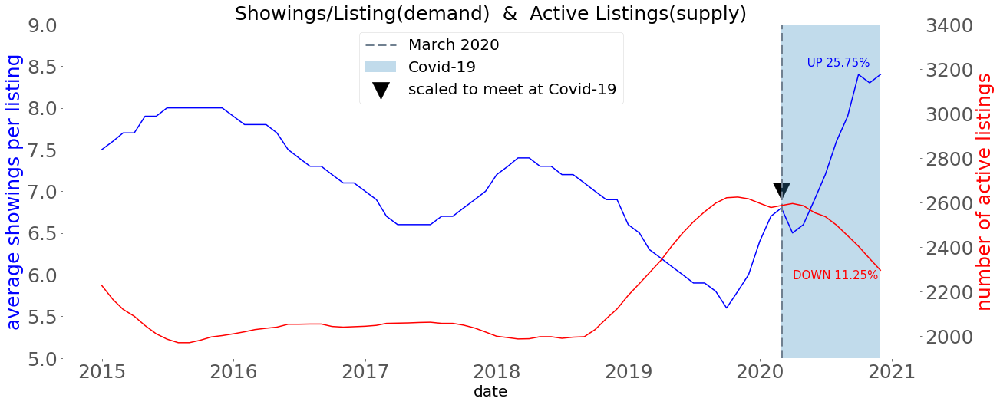

In [7]:
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

active = pd.read_csv('../data/active.csv')
new = pd.read_csv('../data/new.csv')
pending = pd.read_csv('../data/pending.csv')
closed = pd.read_csv('../data/closed.csv')
showings = pd.read_csv('../data/showings.csv')

active = convert_to_date(active, 'date', 'active')
new = convert_to_date(new, 'date', 'new')
pending = convert_to_date(pending, 'date', 'pending')
closed = convert_to_date(closed, 'date', 'closed')
showings = convert_to_date(showings, 'date', 'showings')
activity = active.join(new).join(pending).join(closed).join(showings)

df = all_df[['dtp', 'dtc', 'pcd_mo_year', 'pcd_month']]
df = df.groupby('pcd_mo_year').mean()
activity = df.join(activity)

activity['seasonality'] = [br_stick(x, 5) for x in activity.pcd_month]


active3 = 2586
active12 = 2295
show3 = 6.68
show12 = 8.4
show_delta = active_delta = (show12-show3)/show3, (active12-active3)/active3


fig, ax = plt.subplots(figsize=(20,8))
ax2 = ax.twinx()
ax.plot(activity.index, activity.showings, color='b')
ax2.plot(activity.index, activity.active, color='r')
ax.axvline(x='2020-03-01', linestyle='--', label = 'March 2020', lw=3, color = 'slategrey')
ax.scatter('2020-03-01', 7, s=500, label='scaled to meet at Covid-19', marker='v', color='k')
ax.axvspan('2020-03', '2020-12', alpha=.3, label = 'Covid-19')
ax.set_xlabel('date', fontsize=20, color = 'k')
ax.set_ylabel('average showings per listing', fontsize=25, color='b')
ax.set_ylim(5,9)
ax2.set_ylim(1900,3400)
ax2.set_ylabel('number of active listings', fontsize=25, color='r')
ax.set_title('Showings/Listing(demand)  &  Active Listings(supply)', fontsize=25)
ax.legend(fontsize=20, loc='upper center')
ax2.grid(False)
ax.legend(fontsize=20, loc='upper center')
ax.text('2020-05-01', 8.5, ' UP 25.75%', color='b', fontsize=15)
ax.text('2020-04-01', 5.95, 'DOWN 11.25%', color='r', fontsize=15);
# fig.savefig('../images/supply_and_demand.png')

#### include covid data or not?

In [11]:
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])
all_df[['dom', 'dtp', 'dtc']].describe().T

,count,mean,std,min,25%,50%,75%,max
dom,31799.0,54.448819,33.079581,3.0,34.0,44.0,64.0,244.0
dtp,31799.0,22.091638,30.346489,0.0,4.0,8.0,28.0,180.0
dtc,31799.0,32.357181,11.246252,1.0,26.0,32.0,38.0,77.0


### make sample data subsets and instantiate HypTest class

In [52]:
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

# train = pd.read_csv('../data/train.csv')
sp = all_df[['dtp','pcd_mo_year']][all_df.pcd_mo_year<'2020-03'].set_index('pcd_mo_year')
sp = [val for val in sp.dtp]
sc = all_df[['dtp','pcd_mo_year']][all_df.pcd_mo_year>='2020-03'].set_index('pcd_mo_year')
sc = [val for val in sc.dtp]
s19 = all_df[['dtp','pcd_mo_year']][(all_df.pcd_mo_year<='2019-12') & (all_df.pcd_mo_year>'2019-03')].set_index('pcd_mo_year')
s19 = [val for val in s19.dtp]
s18 = all_df[['dtp','pcd_mo_year']][(all_df.pcd_mo_year<='2018-12') & (all_df.pcd_mo_year>'2018-03')].set_index('pcd_mo_year')
s18 = [val for val in s18.dtp]
s17 = all_df[['dtp','pcd_mo_year']][(all_df.pcd_mo_year<='2017-12') & (all_df.pcd_mo_year>'2017-03')].set_index('pcd_mo_year')
s17 = [val for val in s17.dtp]
s16 = all_df[['dtp','pcd_mo_year']][(all_df.pcd_mo_year<='2016-12') & (all_df.pcd_mo_year>'2016-03')].set_index('pcd_mo_year')
s16 = [val for val in s16.dtp]
s15 = all_df[['dtp','pcd_mo_year']][(all_df.pcd_mo_year<='2015-12') & (all_df.pcd_mo_year>'2015-03')].set_index('pcd_mo_year')
s15 = [val for val in s15.dtp]
sp19 = all_df[['dtp','pcd_mo_year']][all_df.pcd_mo_year<'2019-03'].set_index('pcd_mo_year')
sp19 = [val for val in sp19.dtp]

# from HypTest import *
ht = HypTest([sp, sc, s19, s18, s17, s16, s15, sp19], 
             ['Pre-covid', 'Covid', 'Mar-Dec19', 'Mar-Dec18', 'Mar-Dec17', 'Mar-Dec16', 'Mar-Dec15', 'pre-Mar2019'], 
             alternative='two-sided')

#### sorted values are less clear?

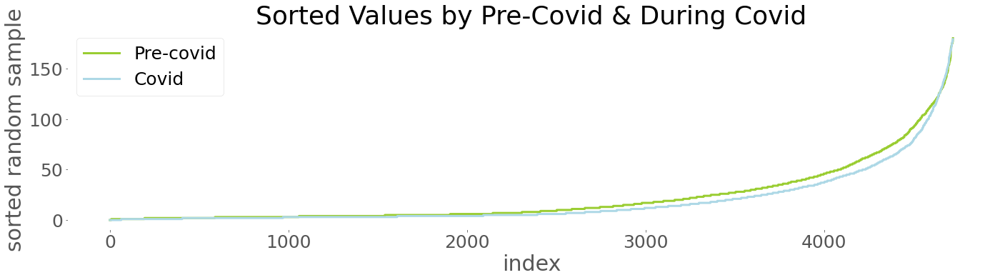

In [55]:
fig, ax = plt.subplots(figsize=(20,6))
ht.plot_sorted(ax, lw=3)
fig.tight_layout()
fig.savefig('../images/sorted.png')

#### descriptive statistics for March to December data and pre vs post covid

In [6]:
ht.descriptive_stats_df()

,Pre-covid,Covid,Mar-Dec19,Mar-Dec18,Mar-Dec17,Mar-Dec16,Mar-Dec15,pre-Mar2019
size,27076.000000,4723.000000,4024.000000,3807.000000,4062.000000,4215.000000,4216.000000,21899.000000
mean,22.750702,18.313360,26.337972,22.277384,21.251846,21.943060,21.084915,21.980684
sd,30.692616,27.979107,32.395007,27.992180,28.224313,29.116188,27.932266,29.993709
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1Q,4.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
median,8.000000,5.000000,12.000000,10.000000,8.000000,9.000000,7.000000,8.000000
3Q,30.000000,22.000000,36.000000,30.000000,28.000000,28.000000,28.000000,28.000000
max,180.000000,179.000000,180.000000,175.000000,180.000000,179.000000,178.000000,180.000000
min_mode,4.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
95% quantile low,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


#### reflected histograms

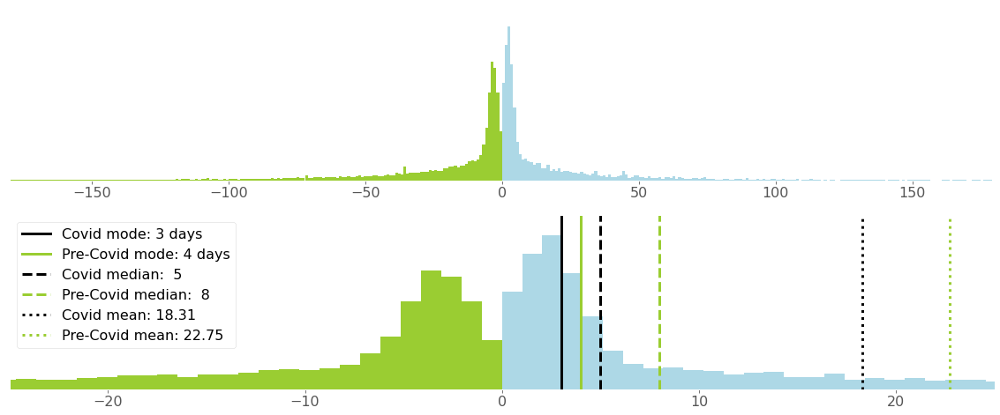

In [4]:
fig, axs = plt.subplots(2, 1)
xlims = [(-180, 180), (-25, 25)]
ylims = [(0,.15), (0,.15)]
bins = [175, 175]
subs = ['Covid', 'Pre']
for ax, xlim, ylim, bin in zip(axs.flatten(), xlims, ylims, bins):
    ax.hist(sc, color='lightblue', density=True, bins=bin)
    ax.hist(0-np.array(sp), color='yellowgreen', density=True, bins=bin)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_yticks([])
    ax.grid(False)
ax.axvline(x = 3, color='k', linestyle='-', linewidth=3, label=f'Covid mode: 3 days')
ax.axvline(x = 4, color='yellowgreen', linestyle='-', linewidth=3, label=f'Pre-Covid mode: 4 days')
ax.axvline(x = np.median(sc), color='k', linestyle='--', linewidth=3, label=f'Covid median: {np.median(sc):2.0f}')
ax.axvline(x = np.median(sp), color='yellowgreen', linestyle='--', linewidth=3, label=f'Pre-Covid median: {np.median(sp):2.0f}')
ax.axvline(x = np.mean(sc), color='k', linestyle=':', linewidth=3, label=f'Covid mean: {np.mean(sc):2.2f}')
ax.axvline(x = np.mean(sp), color='yellowgreen', linestyle=':', linewidth=3, label=f'Pre-Covid mean: {np.mean(sp):2.2f}')
ax.legend();
# fig.suptitle('Pre-Covid -vs- Covid')
fig.savefig('../images/precovid_vs_covid.png')

In [5]:
ht.descriptive_stats_df()

,Pre-covid,Covid,Mar-Dec19,Mar-Dec18,Mar-Dec17,Mar-Dec16,Mar-Dec15,pre-Mar2019
size,27076.000000,4723.000000,4024.000000,3807.000000,4062.000000,4215.000000,4216.000000,21899.000000
mean,22.750702,18.313360,26.337972,22.277384,21.251846,21.943060,21.084915,21.980684
sd,30.692616,27.979107,32.395007,27.992180,28.224313,29.116188,27.932266,29.993709
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1Q,4.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
median,8.000000,5.000000,12.000000,10.000000,8.000000,9.000000,7.000000,8.000000
3Q,30.000000,22.000000,36.000000,30.000000,28.000000,28.000000,28.000000,28.000000
max,180.000000,179.000000,180.000000,175.000000,180.000000,179.000000,178.000000,180.000000
min_mode,4.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
95% quantile low,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


### plot mean, median, mode, sample size

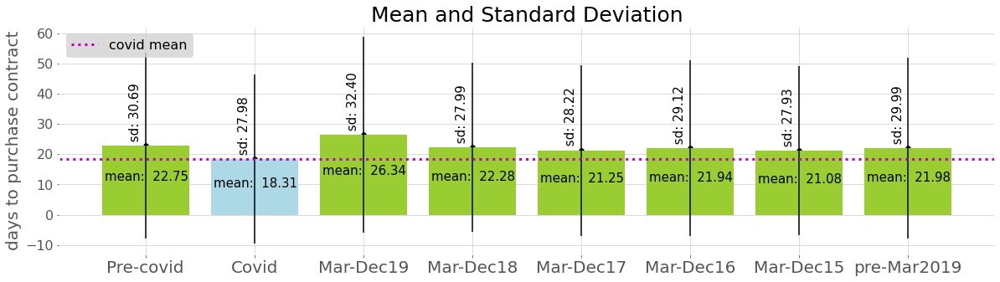

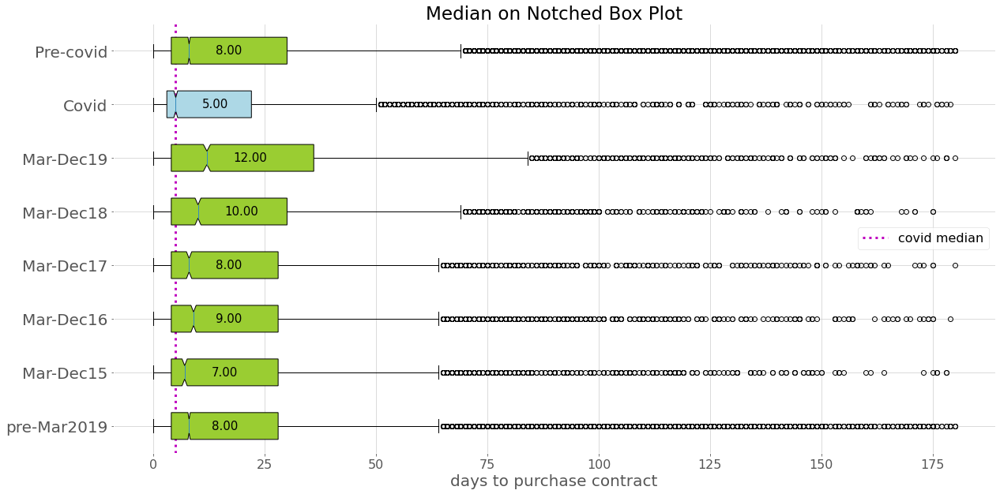

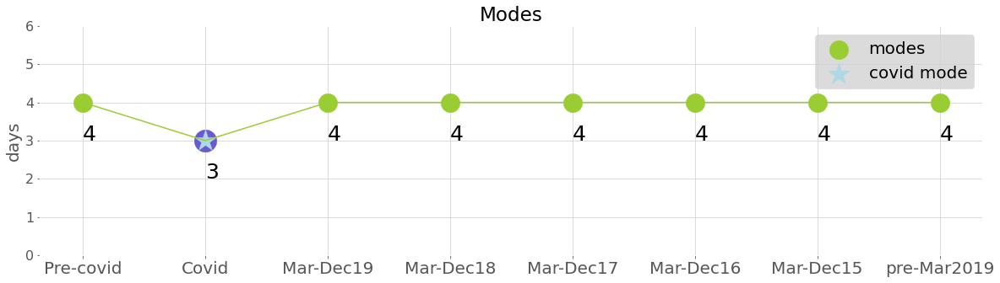

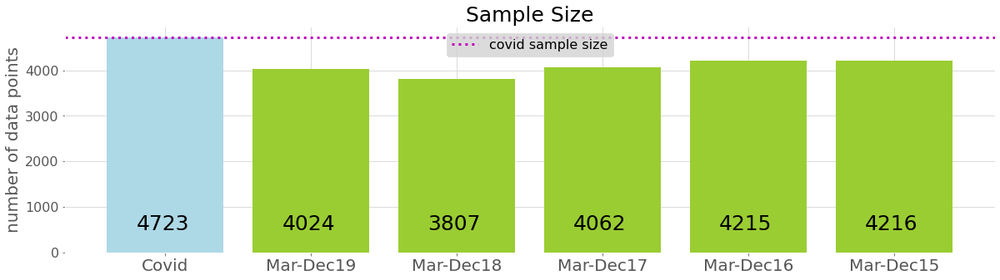

In [6]:
fig, ax = plt.subplots(figsize=(20,5))
ht.plot_mean_sd_all(ax)
fig.savefig('../images/ht_barchart_all.png')
fig, ax = plt.subplots(figsize=(20,10))
ht.box_plot_all(ax)
fig.savefig('../images/ht_boxplot_all.png')
fig, ax = plt.subplots(figsize=(20,5))
ht.mode_line(ax)
fig.savefig('../images/ht_modes_all.png')
fig, ax = plt.subplots(figsize=(20,5))
ht.sample_size(ax)
fig.savefig('../images/ht_size_all.png')

#### mann whitney u test (or rank 2-sample rank test)

In [120]:
n = 1000
np.random.seed(42)
rv_sp = np.random.choice(sp, size=n, replace=True)
rv_sc = np.random.choice(sc, size=n, replace=True)
rv_s19 = np.random.choice(s19, size=n, replace=True)
rv_s18 = np.random.choice(s18, size=n, replace=True)
rv_s17 = np.random.choice(s17, size=n, replace=True)
rv_s16 = np.random.choice(s16, size=n, replace=True)
rv_s15 = np.random.choice(s15, size=n, replace=True)
rv_sp19 = np.random.choice(sp19, size=n, replace=True)

def mannwhitu(col_list, name_list):
        '''input: list of samples, list_of_sample_names, alpha(default is 0.05)
           output: dataframe of pvalues, bonferroni corrected alpha'''
        n = len(col_list)
        arr = np.zeros((n,n))
        for i, sample1 in enumerate(col_list):
            for j, sample2 in enumerate(col_list):
                arr[i,j] = stats.mannwhitneyu(sample1,sample2,alternative='two-sided')[1]
        df = pd.DataFrame(arr, columns=name_list, index=name_list)
        return df


mannwhitu([sp, sc, s19, s18, s17, s16, s15, sp19], 
             ['Pre-covid', 'Covid', 'Mar-Dec19', 'Mar-Dec18', 'Mar-Dec17', 'Mar-Dec16', 'Mar-Dec15', 'pre-Mar2019'])

mannwhitu([rv_sp, rv_sc, rv_s19, rv_s18, rv_s17, rv_s16, rv_s15, rv_sp19], 
             ['Pre-covid', 'Covid', 'Mar-Dec19', 'Mar-Dec18', 'Mar-Dec17', 'Mar-Dec16', 'Mar-Dec15', 'pre-Mar2019'])

,Pre-covid,Covid,Mar-Dec19,Mar-Dec18,Mar-Dec17,Mar-Dec16,Mar-Dec15,pre-Mar2019
Pre-covid,9.999691e-01,7.053710e-07,1.165592e-03,1.204885e-01,6.341167e-01,2.457471e-01,9.489744e-01,0.181146
Covid,7.053710e-07,9.999690e-01,1.295662e-15,8.382779e-11,1.222100e-08,4.816626e-10,3.202206e-07,0.000200
Mar-Dec19,1.165592e-03,1.295662e-15,9.999691e-01,7.754304e-02,3.241492e-03,2.581887e-02,1.129439e-03,0.000005
Mar-Dec18,1.204885e-01,8.382779e-11,7.754304e-02,9.999691e-01,2.503224e-01,6.809358e-01,1.310664e-01,0.003758
Mar-Dec17,6.341167e-01,1.222100e-08,3.241492e-03,2.503224e-01,9.999690e-01,4.498534e-01,6.675032e-01,0.057304
Mar-Dec16,2.457471e-01,4.816626e-10,2.581887e-02,6.809358e-01,4.498534e-01,9.999691e-01,2.514273e-01,0.010679
Mar-Dec15,9.489744e-01,3.202206e-07,1.129439e-03,1.310664e-01,6.675032e-01,2.514273e-01,9.999691e-01,0.156767
pre-Mar2019,1.811461e-01,2.001766e-04,4.933925e-06,3.757553e-03,5.730421e-02,1.067872e-02,1.567674e-01,0.999969


#### levene test for equal var so we can use MW

In [119]:
def levene(col_list, name_list):
        '''input: list of samples, list_of_sample_names, alpha(default is 0.05)
           output: dataframe of pvalues, bonferroni corrected alpha'''
        n = len(col_list)
        arr = np.zeros((n,n))
        for i, sample1 in enumerate(col_list):
            for j, sample2 in enumerate(col_list):
                arr[i,j] = stats.levene(sample1,sample2, center='median')[1]
        df = pd.DataFrame(arr, columns=name_list, index=name_list)
        return df

levene([sp, sc, s19, s18, s17, s16, s15, sp19], 
             ['Pre-covid', 'Covid', 'Mar-Dec19', 'Mar-Dec18', 'Mar-Dec17', 'Mar-Dec16', 'Mar-Dec15', 'pre-Mar2019'])

levene([rv_sp, rv_sc, rv_s19, rv_s18, rv_s17, rv_s16, rv_s15, rv_sp19], 
             ['Pre-covid', 'Covid', 'Mar-Dec19', 'Mar-Dec18', 'Mar-Dec17', 'Mar-Dec16', 'Mar-Dec15', 'pre-Mar2019'])

,Pre-covid,Covid,Mar-Dec19,Mar-Dec18,Mar-Dec17,Mar-Dec16,Mar-Dec15,pre-Mar2019
Pre-covid,1.000000,5.887485e-03,5.741407e-03,0.534015,0.154279,0.898908,0.862400,0.358915
Covid,0.005887,1.000000e+00,2.631379e-08,0.000524,0.152615,0.007370,0.010206,0.073868
Mar-Dec19,0.005741,2.631379e-08,1.000000e+00,0.027194,0.000017,0.003321,0.003411,0.000260
Mar-Dec18,0.534015,5.244962e-04,2.719369e-02,1.000000,0.034348,0.444850,0.424935,0.119597
Mar-Dec17,0.154279,1.526146e-01,1.728728e-05,0.034348,1.000000,0.186556,0.215210,0.651693
Mar-Dec16,0.898908,7.370320e-03,3.321357e-03,0.444850,0.186556,1.000000,0.960307,0.418930
Mar-Dec15,0.862400,1.020608e-02,3.411066e-03,0.424935,0.215210,0.960307,1.000000,0.457283
pre-Mar2019,0.358915,7.386835e-02,2.602452e-04,0.119597,0.651693,0.418930,0.457283,1.000000


### nlp for MarDec19 and Covid

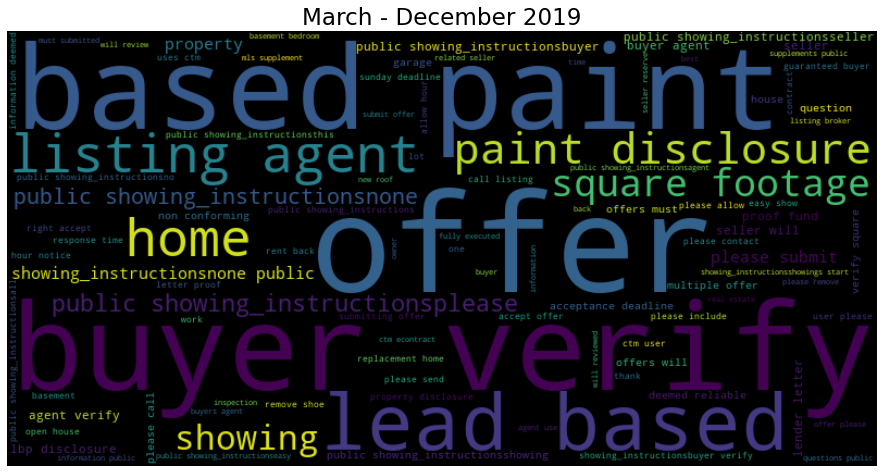

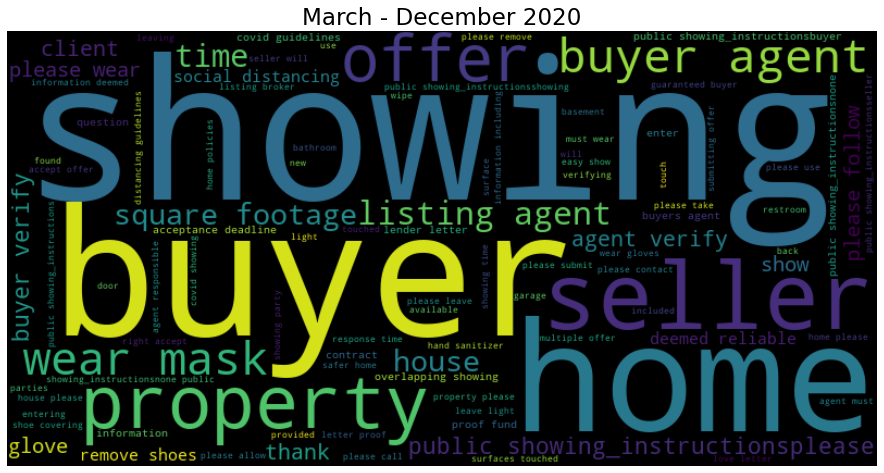

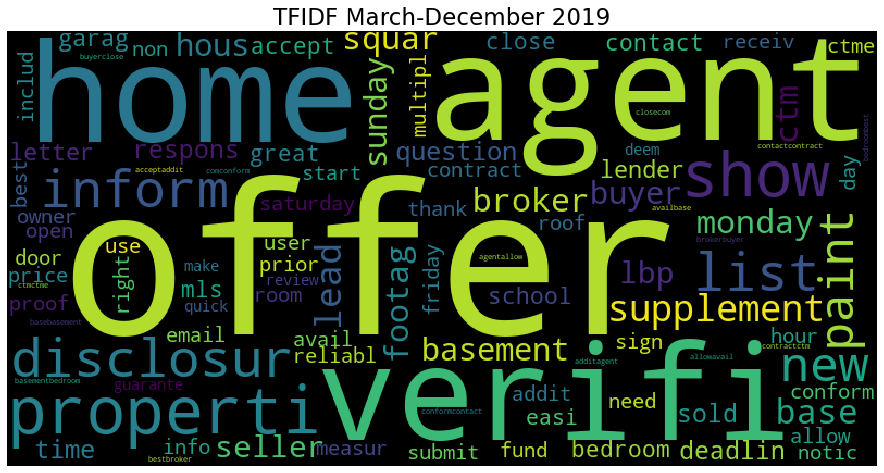

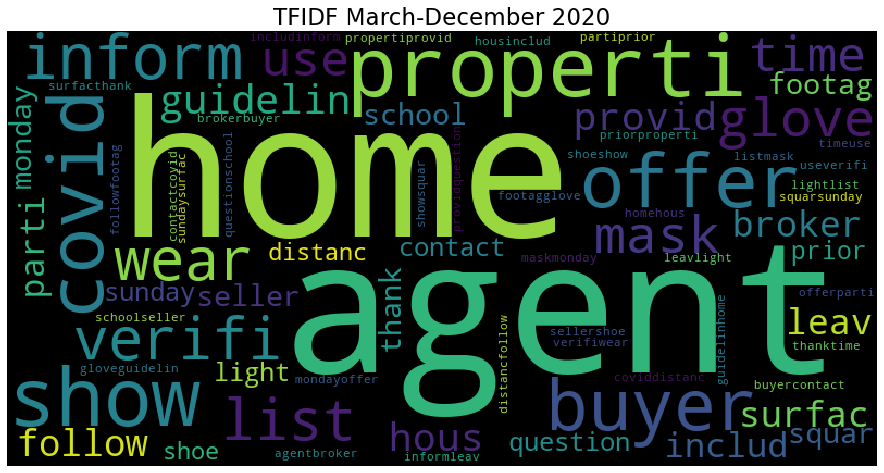

In [127]:
# read in data
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

# text subset of data
sc_nlp = all_df[['all']][all_df.pcd_mo_year>='2020-03'] 
sp_nlp = all_df[['all']][(all_df.pcd_mo_year<='2020-03')]# & (all_df.pcd_mo_year>'2019-03')] 
 
# simplest clean of data
covid = quick_clean(sc_nlp)
pre_2019 = quick_clean(sp_nlp)

# word clouds :)
pre_2019_plot = word_cloud(pre_2019, collocations=True)
fig, ax = plt.subplots()
ax.imshow(pre_2019_plot, interpolation='bilinear')
ax.axis('off')
ax.set_title('March - December 2019');
fig.savefig('../images/wc_pre.png')

covid_plot = word_cloud(covid, collocations=True)
fig, ax = plt.subplots()
ax.imshow(covid_plot, interpolation='bilinear')
ax.axis('off')
ax.set_title('March - December 2020');
fig.savefig('../images/wc_covid.png')


#tfidf word clouds
s19_corpus = list(sp_nlp.values)
s19_corpus = [text for text in sp_nlp['all']]

sc_corpus = list(sc_nlp.values)
sc_corpus = [text for text in sc_nlp['all']]

s19_bow = tfidf_bow(s19_corpus, max_df=.99, min_df=500, max_features=100)
sc_bow = tfidf_bow(sc_corpus, max_df=.99, min_df=500, max_features=100)

fig, ax = plt.subplots()
ax.imshow(word_cloud(s19_bow), interpolation='none')
ax.axis('off')
ax.set_title('TFIDF March-December 2019');
fig.savefig('../images/tfidf_pre.png')

fig, ax = plt.subplots()
ax.imshow(word_cloud(sc_bow), interpolation='none')
ax.axis('off')
ax.set_title('TFIDF March-December 2020');
fig.savefig('../images/tfidf_covid.png')


# WITHOUT COVID DATA FROM HERE ON

### spatial dependence by mean DTP

In [129]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])

all_df.zip = [80209 if z==90209 else z for z in all_df.zip]
all_df['dtp_count'] = all_df.dtp
zips_counts = dtp_lat_long = all_df[['dtp_count','zip']].groupby('zip').count()
zips = dtp_lat_long = all_df[['dtp','close_price', 'lat', 'long', 'zip']].groupby('zip').mean()
zips = zips.join(zips_counts)
zips.dropna(inplace=True)
zips = zips.sort_values(by='dtp')

n, av, sd, mn, q1, q2, q3, mx =zips.dtp.describe()
print(n, av, sd, mn, q1, q2, q3, mx)
# 17.592322749021314
# 21.050847457627118
# 24.566974991435423
# 31.839359391965253
zips['colors'] = pd.cut(zips.dtp, bins = [-1,1,q1,q2,q3,mx], labels = ['white','lightgreen', 'green', 'darkgreen', 'black'])
zips['lat_long'] = [(lat, long) for lat, long in zip(zips.lat, zips.long)]
zips['name_list'] = [str(z) for z in zips.index]
zips['code_dtp'] = [(int(z), round(dtp,2), round(price,0), cnt) for z, dtp, price, cnt in zip(zips.name_list, zips.dtp, zips.close_price, zips.dtp_count)]

denver_coords = [39.726256, -104.966362]

#Create the map
my_map = folium.Map(location = denver_coords, zoom_start = 11)

def add_marker(lat_long_list, name_list, color_list, map_name):
    for lat_long, name, col in zip(lat_long_list, name_list, color_list):
        folium.Marker(lat_long, tooltip=name, icon=folium.Icon(icon='home', color=col)).add_to(map_name)
    return map_name

add_marker(zips.lat_long, zips.code_dtp, zips.colors, my_map)
# my_map.save('my_map.html')

38.0 24.24457336811775 11.840398652664703 1.0 19.155270475227503 22.792105313165095 25.738658889155907 70.0


### all points for spatial dependence analysis

26376.0 22.65624052168638 30.42684530128161 0.0 4.0 8.0 30.0 180.0


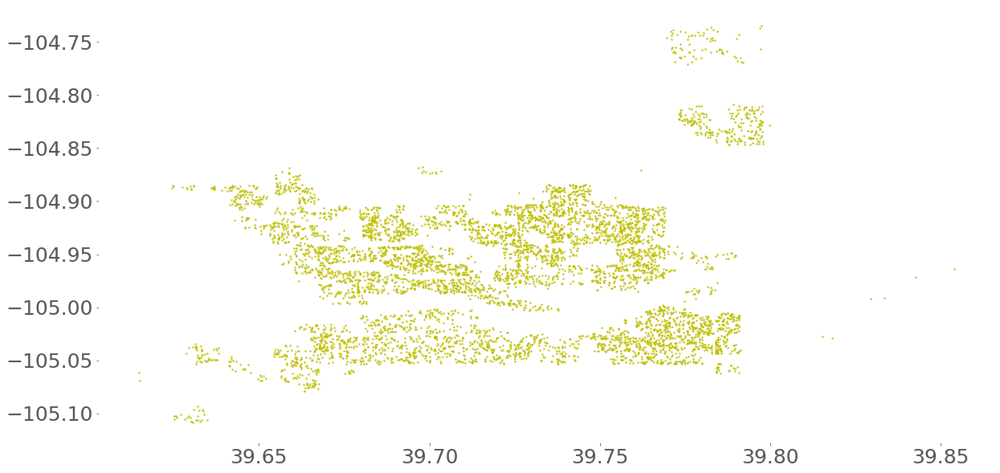

In [35]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])

samp_dtp = all_df[['lat', 'long', 'dtp']]#.sample(n = 1000, random_state=42)
n, av, sd, mn, q1, q2, q3, mx = samp_dtp.dtp.describe()
print(n, av, sd, mn, q1, q2, q3, mx)

q1 = samp_dtp[['lat', 'long']][all_df.dtp<=4]
q2 = samp_dtp[['lat', 'long']][(all_df.dtp>4) & (all_df.dtp<=8)]
q3 = samp_dtp[['lat', 'long']][(all_df.dtp>8) & (all_df.dtp<=30)]
q4 = samp_dtp[['lat', 'long']][all_df.dtp>30]

fig, ax = plt.subplots(figsize=(20,10))
ax.scatter(q1.lat, q1.long, s=3, color='r')
ax.scatter(q2.lat, q2.long, s=3, color='b')
ax.scatter(q3.lat, q3.long, s=3, color='g')
ax.scatter(q4.lat, q4.long, s=3, color='y');

In [137]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])


all_df.zip = [80209 if z==90209 else z for z in all_df.zip]
size = len(all_df.zip.unique())*30
test_frac = 1
n = int(1140*test_frac)
samp_dtp = all_df[['lat', 'long', 'dtp']]#.sample(n = 500, random_state=42)
n, av, sd, mn, q1, q2, q3, mx = samp_dtp.dtp.describe()
print(n, av, sd, mn, q1, q2, q3, mx)

samp_dtp['colors'] = pd.cut(samp_dtp.dtp, bins = [-1,-0.1,q1,q2,q3,mx], labels = ['white','lightgreen', 'green', 'darkgreen', 'black'])
samp_dtp['lat_long'] = [(lat, long) for lat, long in zip(samp_dtp.lat, samp_dtp.long)]


denver_coords = [39.726256, -104.966362]

#Create the map
# tiles='Stamen Toner'
m = folium.Map(location = denver_coords, zoom_start = 11, tiles='openstreetmap')

def add_marker(lat_long_list, color_list, pop_list,  map_name):
    for lat_long, col, pop in zip(lat_long_list, color_list, pop_list):
        folium.CircleMarker(lat_long, radius=1, popup=pop, color=col, fill=True, fill_opacity=1).add_to(map_name)
    return map_name

add_marker(samp_dtp.lat_long, samp_dtp.colors, samp_dtp.dtp, m)
# m.save('all_points_map.html')

26376.0 22.65624052168638 30.42684530128161 0.0 4.0 8.0 30.0 180.0


### broken stick estimation -- not using covid data

const      24.151845
lhs_x      -6.983352
rhs_x      -0.338130
lhs_xsq     1.236769
rhs_xsq     0.729093
dtype: float64 0.8406247084266938


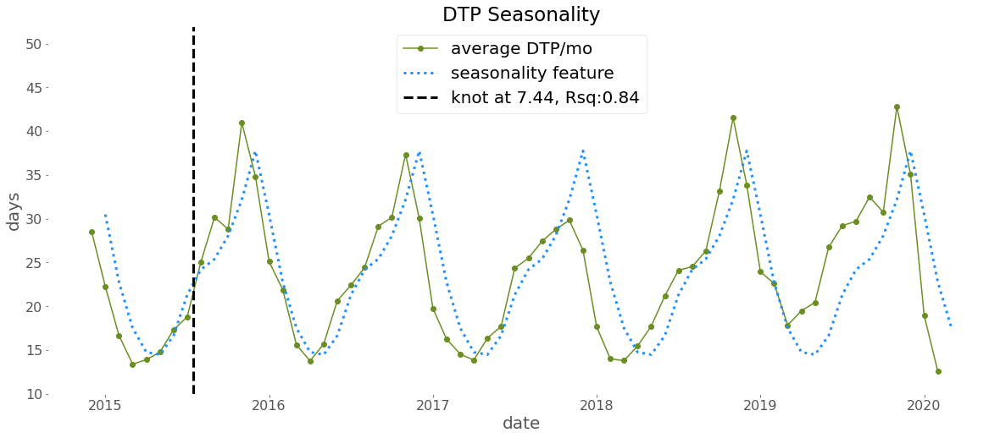

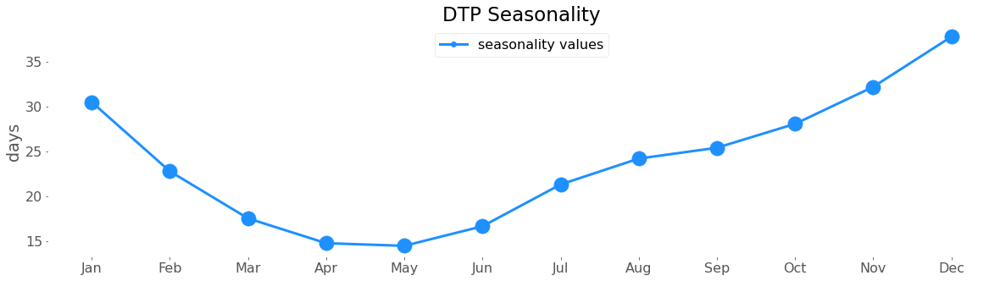

In [155]:
all_the_data_train = pd.read_csv('../data/all_the_data_train.csv')
all_the_data_holdout = pd.read_csv('../data/all_the_data_holdout.csv')
all_df = pd.concat([all_the_data_train, all_the_data_holdout])

df = all_df[['dtp', 'dtc', 'pcd_mo_year', 'pcd_month']]
df = df[df.pcd_mo_year<'2020-03-01']
df = df.groupby('pcd_mo_year').mean()

rsq, b = rsq_best_b(df)
y = broken_stick_feature(b, df)
seasonality_by_month = y.unique()

fig, ax = plt.subplots(figsize=(20,8))
ax.plot(df.index, df.dtp, label='average DTP/mo', color='olivedrab', marker='o')
ax.plot(np.arange(1,64), y, label = 'seasonality feature', color='dodgerblue', linestyle=':', lw=3)
ax.axvline(x=b, label=f'knot at {b:2.2f}, Rsq:{rsq:2.2f}', 
           color='k', linestyle='--', linewidth=3)
ax.set_xticks(np.arange(1,64,12))
ax.set_xticklabels([ '2015',  '2016',  '2017',  '2018',  '2019',  '2020'])
ax.set_title('DTP Seasonality')
ax.set_xlabel('date', fontsize=20)
ax.set_ylabel('days', fontsize=20)
ax.set_ylim(10,52)
ax.legend(fontsize=20, loc="upper center");
# fig.savefig('../images/brokenstick_fit.png')
# fig.savefig('../images/dtp_no_covid_fit.png')


fig, ax = plt.subplots(figsize=(20,5))
ax.plot(np.arange(1,13), seasonality_by_month, 
        color='dodgerblue', label='seasonality values', 
        marker='o',linewidth=3)
ax.scatter(np.arange(1,13), seasonality_by_month, 
        color='dodgerblue', s=300)
ax.set_xticks(np.arange(1,13))
ax.set_xticklabels([ 'Jan',  'Feb',  'Mar',  'Apr',  'May',  'Jun', 'Jul',  'Aug',  'Sep',  'Oct',  'Nov',  'Dec'])
ax.set_ylabel('days')
ax.set_title('DTP Seasonality')
ax.legend(loc='upper center');
# fig.savefig('../images/seasonality_by_month.png')

### correlation with price 
* DTP, DTC, DOM don't look correlated with price  (107 = 0.4% datapoints > $2M)
* price is sneaking in with ratio

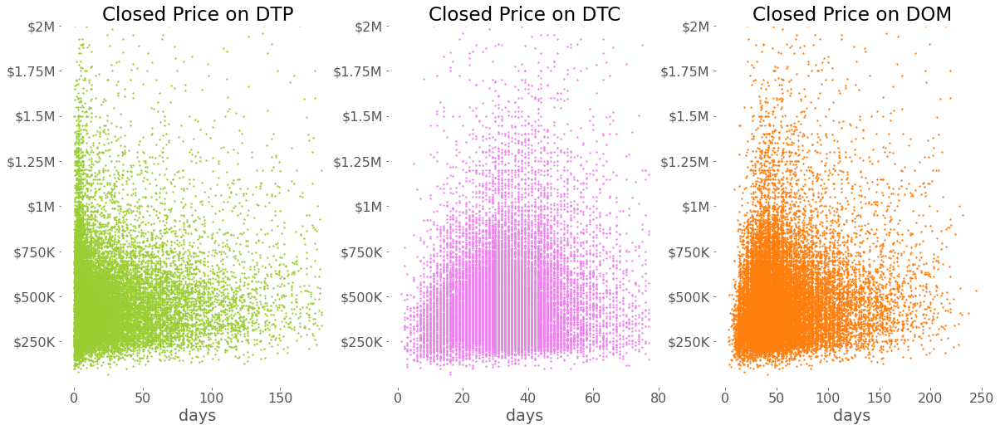

In [152]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])

col_list = ['dtp', 'dtc', 'dom']
title_list = ['Closed Price on DTP', 'Closed Price on DTC', 'Closed Price on DOM']
color_list = ['yellowgreen', 'violet', 'tab:orange']
fig, axs = plt.subplots(1, 3)
for ax, col, ttl, clr in zip(axs.flatten(), col_list, title_list, color_list):
    ax.scatter(all_df[col], all_df.close_price/100000,  s=3, color=clr)
    ax.set_ylim(0,20)
    ax.set_title(ttl)
    ax.set_xlabel('days')
    yticks = [2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20]
    ax.set_yticks(yticks)
    ax.set_yticklabels(['$250K', '$500K', '$750K', '$1M', '$1.25M', '$1.5M', '$1.75M', '$2M'])
    ax.grid(False)
fig.savefig('../images/price_targets.png')

#### correlation matrix for price proxies

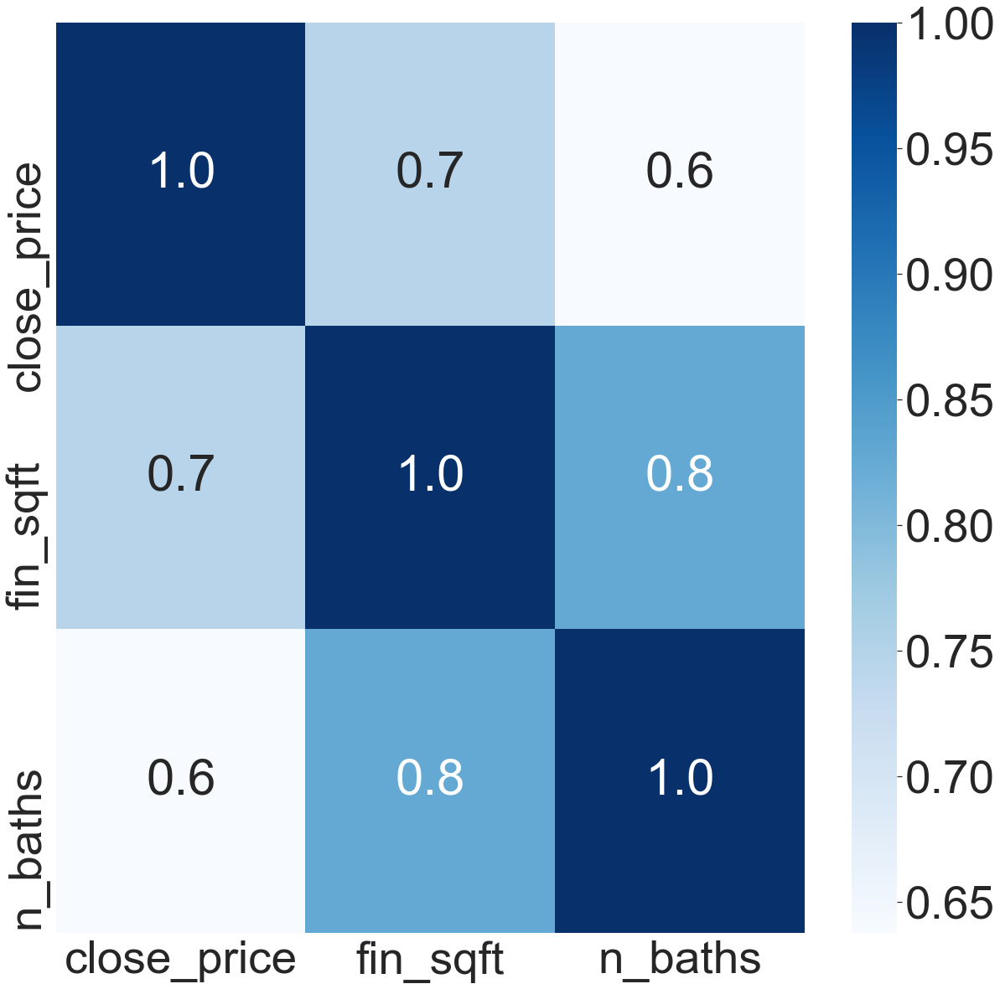

In [39]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])

numeric = ['dtp', 'dtc', 'dom', 'ratio', 'fin_sqft',
           'inventory', 'good_agent', 'n_baths', 'n_beds', 
           'n_fireplaces','n_photos', 'orig_price', 
           'close_price', 'lot_sqft','walkscore', 
           'psf', 'em', 'ba_comp', 'garage_spaces', 'year_built']

hi_corr1 = ['dtc','dom','dtp', 'ratio']

hi_corr2 = ['close_price', 'fin_sqft','n_baths']
           
# corrMatrix = train[hi_corr1].corr()
# fig, ax = plt.subplots(figsize=(20,20))
# sn.heatmap(corrMatrix,
#                 cmap='coolwarm',
#                 annot=True,
#                 fmt=".1f",
#                 annot_kws={'size':50},
#                 cbar=False,
#                 square=True)

fig.savefig('../images/highly_corr1_heatmap.png')

corrMatrix = train[hi_corr2].corr()
fig, ax = plt.subplots(figsize=(20,20))
sn.set(font_scale=5)
sn.heatmap(corrMatrix,
                cmap='Blues',
                annot=True,
                fmt=".1f")

fig.savefig('../images/highly_corr2_heatmap.png')

#### ratio on close price

(0.004056718228692751, 0.9967394601152563)

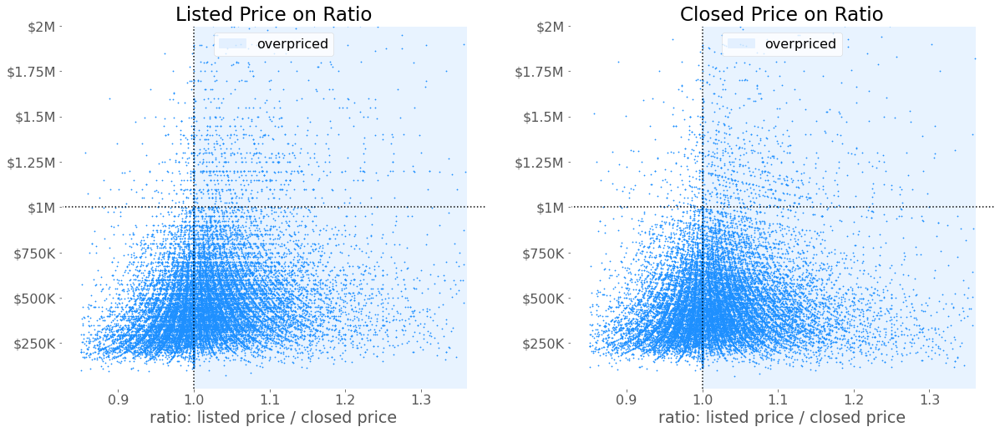

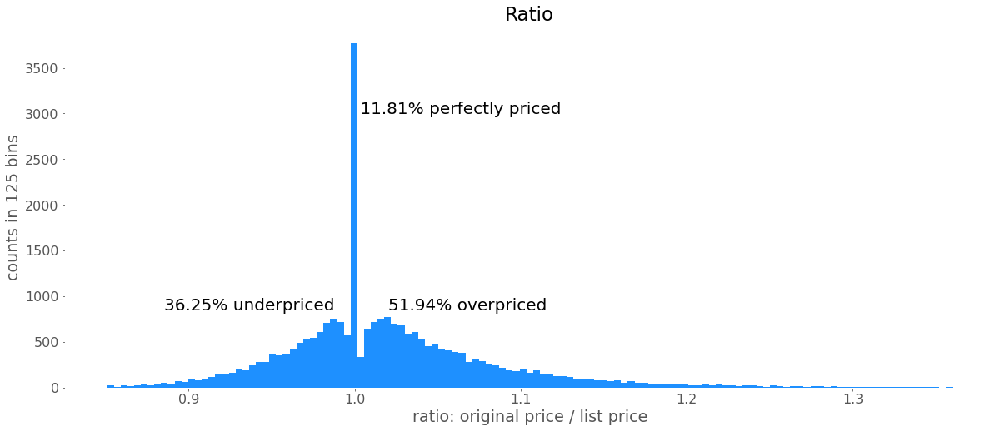

In [8]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])

pp = (all_df.ratio==1).mean()*100
up = (all_df.ratio<1).mean()*100
op = (all_df.ratio>1).mean()*100

col_list = ['orig_price', 'close_price']
title_list = ['Listed Price on Ratio', 'Closed Price on Ratio']
fig, axs = plt.subplots(1, 2)
for ax, col, ttl in zip(axs.flatten(), col_list, title_list):
    ax.scatter(all_df.ratio, all_df[col]/100000,  s=1.5, color='dodgerblue')
    ax.set_ylim(0,20)
    ax.set_title(ttl)
    ax.set_xlabel('ratio: listed price / closed price')
    yticks = [2.5, 5, 7.5, 10, 12.5, 15, 17.5, 20]
    ax.set_yticks(yticks)
    ax.set_yticklabels(['$250K', '$500K', '$750K', '$1M', '$1.25M', '$1.5M', '$1.75M', '$2M'])
    ax.axvspan(1,all_df.ratio.max(), color='dodgerblue', alpha=.1, label='overpriced')
    ax.legend(loc='upper center', facecolor='white')
    ax.grid(False)
    ax.axvline(x=1,linestyle=':', color='k')
    ax.axhline(y=10, linestyle=':', color='k')
    
fig.savefig('../images/price_ratio.png')

fig, ax = plt.subplots()
ax.hist(all_df.ratio, bins = 125, color='dodgerblue');
# ax.set_ylim(0,1000)
ax.set_title('Ratio')
ax.set_ylabel('counts in 125 bins')
ax.set_xlabel('ratio: original price / list price')
ax.text(1, 3000, f' {pp:2.2f}% perfectly priced', fontsize=20)
ax.text(.885, 850 , f'{up:2.2f}% underpriced', fontsize=20)
ax.text(1.02, 850, f'{op:2.2f}% overpriced', fontsize=20);

fig.savefig('../images/ratio.png')

d = {'<= $1M': [25261, 95.77, 37.24, 11.86, 50.90, 21.87, 32.40, 54.27],
     '> $1M': [1115, 4.23, 13.81, 10.49, 75.70, 40.47, 38.48, 78.95]}

pd.DataFrame.from_dict(d, orient='index', 
                       columns=['size', '% of data', '% underpriced', '% perfectly priced', '% overpriced', 'mean DTP', 'mean DTC', 'mean DOM'])

(all_df.orig_price>2000000).mean(), 1 - (all_df.close_price>2000000).mean()

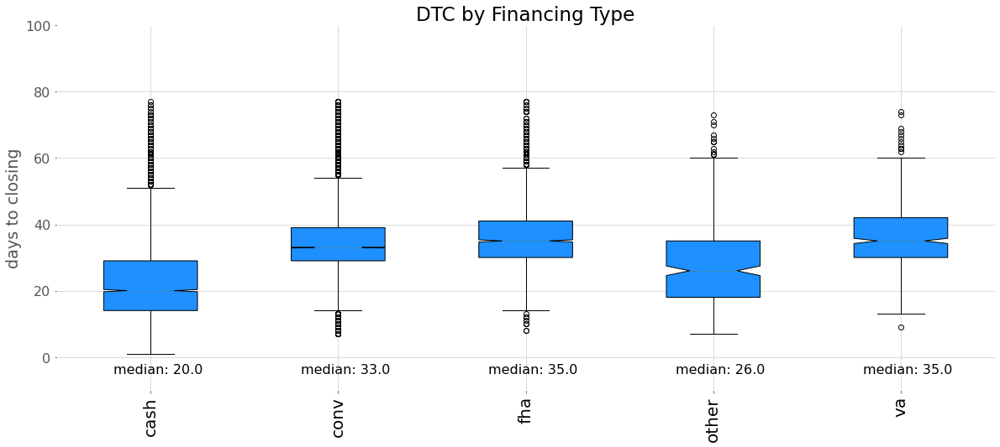

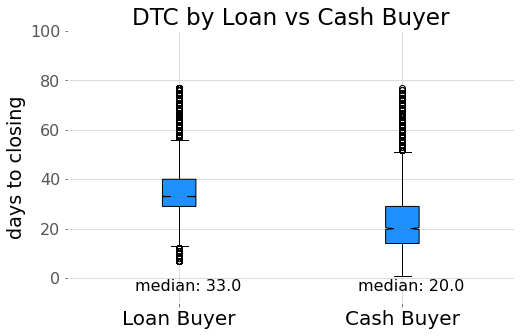

In [6]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])
all_df['str_cash'] = [str(val) for val in all_df.with_cash]

fig, ax = plt.subplots()
eda = EDA(all_df)
eda.box_by_level(ax,'financing', 'dtc', color='dodgerblue')
ax.set_ylim(-10,100)
ax.set_title('DTC by Financing Type')
ax.set_ylabel('days to closing');
# fig.savefig('../images/dtc_financing.png')

fig, ax = plt.subplots(figsize=(8,5))
eda = EDA(all_df)
eda.box_by_level(ax,'with_cash', 'dtc', color='dodgerblue')
ax.set_ylim(-10,100)
ax.set_title('DTC by Loan vs Cash Buyer')
ax.set_xticklabels(['Loan Buyer', 'Cash Buyer'], rotation=0)
ax.set_ylabel('days to closing', color='k');
# fig.savefig('../images/dtc_cash_buyer.png')

# MODELS

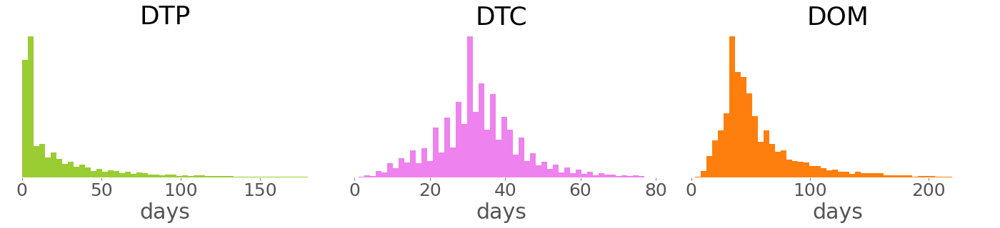

In [62]:
train = pd.read_csv('../data/train.csv')
holdout = pd.read_csv('../data/holdout.csv')
all_df = pd.concat([train, holdout])

col_list = ['dtp', 'dtc', 'dom']
title_list = ['DTP', 'DTC', 'DOM']
color_list = ['yellowgreen', 'violet', 'tab:orange']
fig, axs = plt.subplots(1, 3, figsize=(20,5))
for ax, col, ttl, clr in zip(axs.flatten(), col_list, title_list, color_list):
    ax.hist(all_df[col], bins = 50, color=clr, density=True)
    ax.set_title(ttl)
    ax.set_xlabel('days')
    ax.set_yticks([])
    ax.grid(False)
fig.tight_layout()
fig.savefig('../images/targets.png')

## DTC

No handles with labels found to put in legend.


const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023


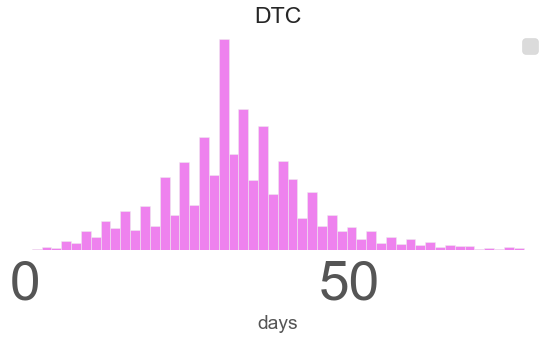

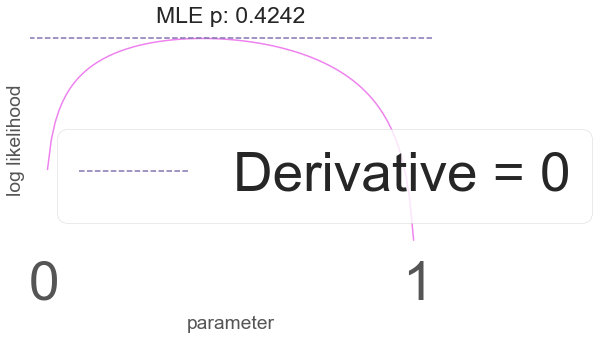

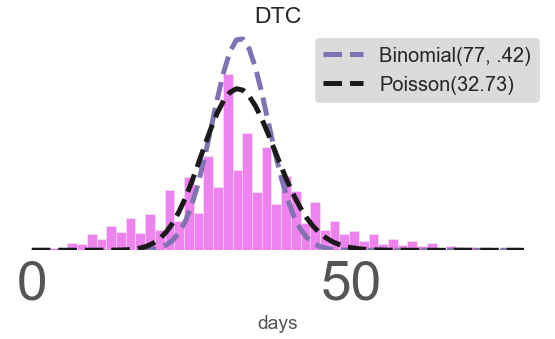

In [42]:
T = pd.read_csv('../data/train.csv')
# T['broken_stick'] = [br_stick(x, 5) for x in T.pcd_month]
# 
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100

fig, ax = plt.subplots(figsize=(8,5))
ax.hist(T.dtc, bins=50, color='violet', density=True)
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTC')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/dtc_hist.png')

fig, ax = plt.subplots(figsize=(8,5))
mle_binom = binom_mle(ax, 0, 77, T.dtc, clr='violet')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/dtc_mle_binom.png')

x = np.arange(78)
ypois = stats.binom(n=77, p = 0.4242).pmf(x)
fig, ax = plt.subplots(figsize=(8,5))
ax.hist(T.dtc, bins=50, color='violet', density=True)
ax.plot(x, ypois, linestyle='--', linewidth=5, label='Binomial(77, .42)', color='m')
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTC')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
# fig.savefig('../images/dtc_binom.png')

x = np.arange(78)
ypois = stats.poisson(mu=32.7273).pmf(x)
# fig, ax = plt.subplots(figsize=(8,5))
# ax.hist(T.dtc, bins=50, color='violet', density=True)
ax.plot(x, ypois, linestyle='--', linewidth=5, label='Poisson(32.73)', color='k')
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTC')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/dtc_poisson_both.png')

No handles with labels found to put in legend.


const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023


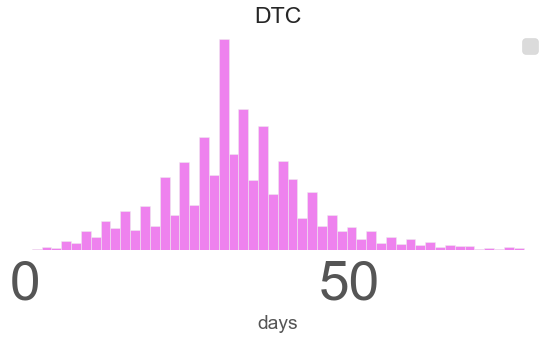

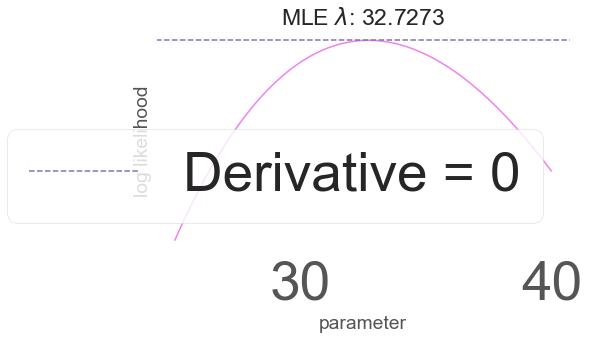

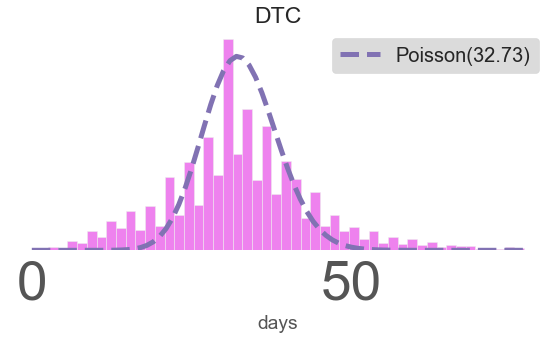

In [43]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100

fig, ax = plt.subplots(figsize=(8,5))
ax.hist(T.dtc, bins=50, color='violet', density=True)
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTC')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/dtc_hist.png')

fig, ax = plt.subplots(figsize=(8,5))
mle_pois = pois_mle(ax, 25, 40, T.dtc, clr='violet')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/dtc_mle_lam.png')


x = np.arange(78)
ypois = stats.poisson(mu=32.7273).pmf(x)
fig, ax = plt.subplots(figsize=(8,5))
ax.hist(T.dtc, bins=50, color='violet', density=True)
ax.plot(x, ypois, linestyle='--', linewidth=5, label='Poisson(32.73)', color='m')
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTC')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/dtc_poisson.png')



const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
nb mae cv results: [7.815632374570188, 7.677856985732913, 7.833693330248615, 7.931773311739048, 7.9003106672745655]
nb rmse cv results: [10.36349224108861, 10.230366155473353, 10.37401215013883, 10.486560045388051, 10.533354700304665]
mean nb mae cv: 7.831853333913065
mean nb rmse cv: 10.397557058478702
gb cv mae results: [-7.91636013 -7.95706395 -7.82850909 -7.90117625 -7.74808044]
gb cv rmse results: [-10.59052062 -10.5280563  -10.37830309 -10.59978197 -10.31831758]
mean gb mae cv: -7.870237972369443
mean gb rmse cv: -10.482995913421544
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtc   No. Observations:                16873
Model:                            GLM   Df Residuals:                    16869
Model Family:        NegativeBinomial   Df Model:                            3


No handles with labels found to put in legend.


NB: The mean absolute error (MAE) on test set: 7.8484
NB: The root mean squared error (RMSE) on test set: 10.4370
GB: The mean absolute error (MAE) on test set: 7.8538
GB: The root mean squared error (RMSE) on test set: 10.4644
MEAN: The mean absolute error (MAE) on test set: 8.5651
MEAN: The root mean squared error (RMSE) on test set: 11.5025
MEDIAN: The mean absolute error (MAE) on test set: 8.5120
MEDIAN: The root mean squared error (RMSE) on test set: 11.5207


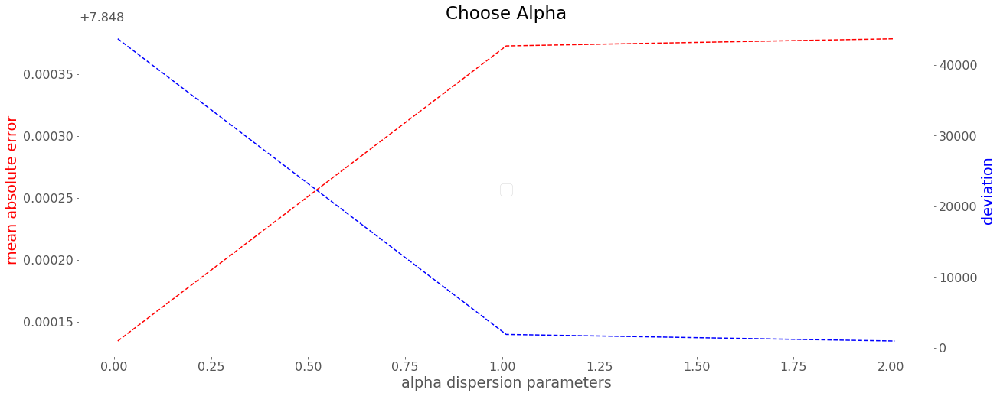

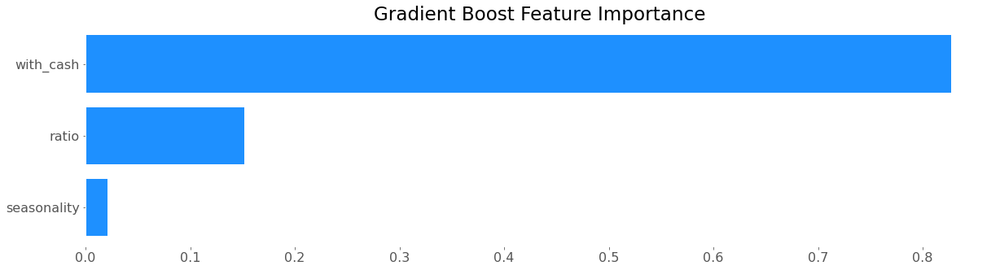

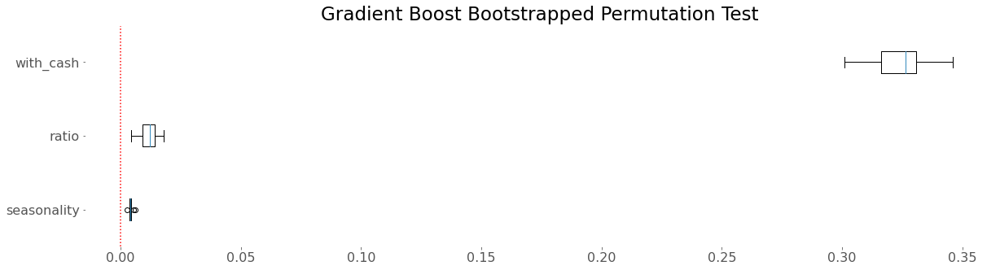

In [22]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtc_df = T[['dtc', 'with_cash', 'ratio', 'seasonality']]

nb_gb = NB_GB(dtc_df, 'dtc', alpha=1.01)
nb_gb.cv_nb()
nb_gb.cv_gb()
yhat_dtc_nb, yhat_dtc_gb = nb_gb.res()

fig, ax = plt.subplots()
nb_gb.choose_alpha(ax)
plt.show()

fig, ax = plt.subplots(figsize=(20,5))
nb_gb.feat_import(ax)
fig.savefig('../images/dtc_feature_imp.png')

fig, ax = plt.subplots(figsize=(20,5))
nb_gb.perm_import(ax)
fig.savefig('../images/dtc_perm_imp.png')

### DTC equation and fake result

\\
dtc_{\text{cash buyer}} = e^{3.5523}e^{-0.4193(1)}/\left (1 - e^{3.5523}e^{-0.4193(1)}  \right )\approx \text{23 days}
\\
dtc_{\text{non-cash buyer}} = e^{3.5523}e^{-0.4193(0)}/\left (1 - e^{3.5523}e^{-0.4193(0)}  \right )\approx \text{35 days}

In [27]:
def undo_nb(coef, xval, alpha=1.01):
    e = (np.e**coef[0])*(np.e**(coef[1]*int(xval)))
    y = (1/alpha)*(e/(1-e))
    return e

# coef = [3.2291, -0.3915]
# xval_cash = [1,1]
# xval_notcash = [1,0]
# undo_nb(coef, xval_cash), undo_nb(coef, xval_notcash)

undo_nb([3.5523, -0.4193], 1), undo_nb([3.5523, -0.4193], 0)

(22.942704516986222, 34.89348026968447)

### looking at the DTP data distributions and split + MLEs

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023


,n,%,mean,var,sd,min,q1,med,q3,max,mean ratio,median ratio,%up,%pp,%op
quick,10964.0,0.519818,4.124042,4.153726,2.038069,0.0,3.0,4.0,5.0,9.0,98.510741,98.992201,0.601332,0.159522,0.239146
slow,10128.0,0.480182,42.645142,1141.197654,33.781617,10.0,18.0,31.0,56.0,180.0,105.800978,104.440721,0.101007,0.071781,0.827212


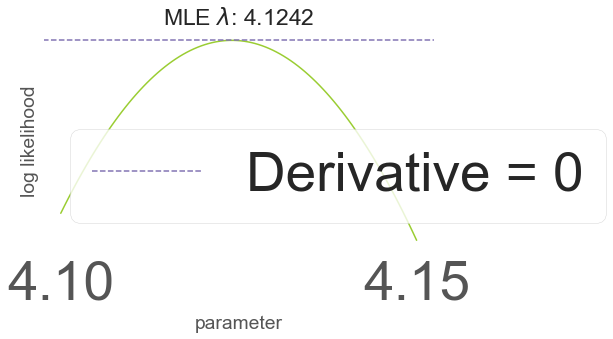

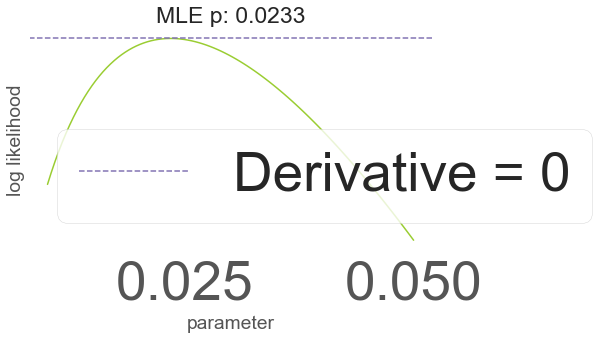

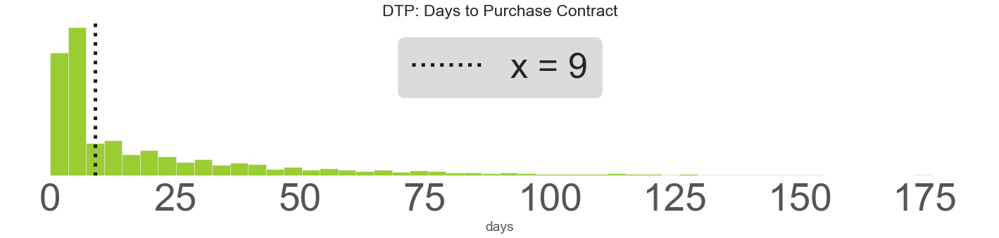

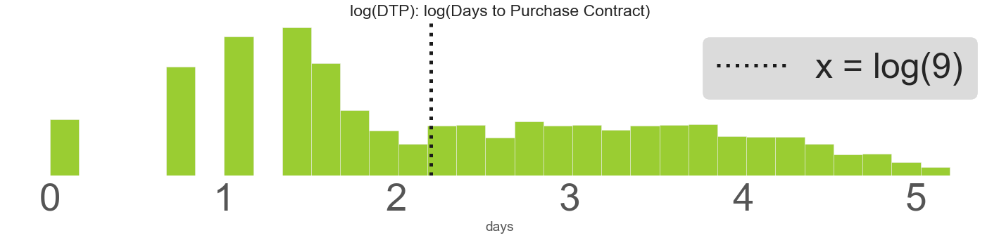

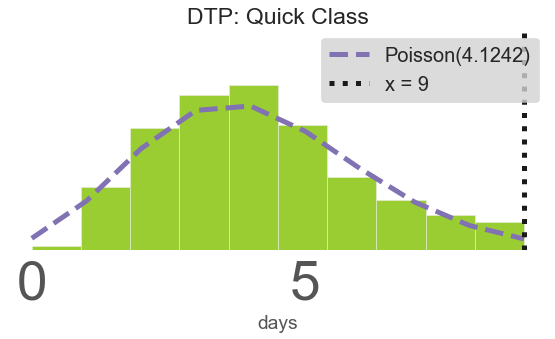

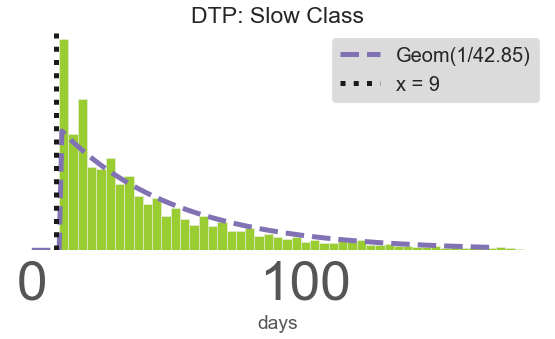

In [46]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100

qcounts = T.dtp.value_counts()[:8]
qy = T[['dtp', 'ratio']][T.dtp<=9]
qn, qmean, qsd, qmin, qq1, qmed, qq3, qmax = qy['dtp'].describe().T
qvar = qsd**2
qperc = qn/T.shape[0]
qratio_mean = qy.ratio.mean()
qratio_med = qy.ratio.median()
qup = (qy.ratio<100).mean()
qpp = (qy.ratio==100).mean()
qop = (qy.ratio>100).mean()
q_stats = [qn, qperc, qmean, qvar, qsd, qmin, qq1, qmed, qq3, qmax, qratio_mean, qratio_med, qup, qpp, qop]

sy = T[['dtp', 'ratio']][T.dtp>9]
sn, smean, ssd, smin, sq1, smed, sq3, smax = sy['dtp'].describe().T
svar = ssd**2
sperc = sn/T.shape[0]
sratio_mean = sy.ratio.mean()
sratio_med = sy.ratio.median()
sup = (sy.ratio<100).mean()
spp = (sy.ratio==100).mean()
sop = (sy.ratio>100).mean()
s_stats = [sn, sperc, smean, svar, ssd, smin, sq1, smed, sq3, smax, sratio_mean, sratio_med, sup, spp, sop]

# dataframe of stats for classes
q_s_stats = pd.DataFrame(data=[q_stats, s_stats], 
             index = ['quick', 'slow'], 
             columns=['n', '%', 'mean', 'var', 'sd', 'min', 'q1', 'med', 'q3', 'max', 
                      'mean ratio', 'median ratio', '%up', '%pp', '%op'])

# MLEs for lambda and p
fig, ax = plt.subplots(figsize=(8,5))
mle_pois = pois_mle(ax, 4.1, 4.15, qy.dtp)
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/mle_lam.png')

fig, ax = plt.subplots(figsize=(8,5))
mle_geom = geom_mle(ax, 0.01, .05, sy.dtp)
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/mle_p.png')

fig, ax = plt.subplots(figsize=(20,5))
ax.hist(T.dtp, bins=50, color='yellowgreen', density=True)
ax.axvline(x=9, linestyle = ':', linewidth=5, color='k', label='x = 9')
ax.legend(fontsize=50, loc='upper center', facecolor='lightgrey')
ax.set_title('DTP: Days to Purchase Contract')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/9dtp.png')

fig, ax = plt.subplots(figsize=(20,5))
ax.hist(np.log(T.dtp[T.dtp>0]), bins=31, color='yellowgreen', density=True)
ax.axvline(x=np.log(9), linestyle = ':', linewidth=5, color='k', label='x = log(9)')
ax.legend(fontsize=50, loc='upper right', facecolor='lightgrey')
ax.set_title('log(DTP): log(Days to Purchase Contract)')
ax.set_xlabel('days')
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/log_9dtp.png')

x = np.arange(10)
ypois = stats.poisson(mu=4.1242).pmf(x)
fig, ax = plt.subplots(figsize=(8,5))
ax.hist(qy.dtp, bins=10, color='yellowgreen', density=True)
ax.plot(x, ypois, linestyle='--', linewidth=5, label='Poisson(4.1242)', color='m')
ax.axvline(x=9, linestyle = ':', linewidth=5, color='k', label='x = 9')
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTP: Quick Class')
ax.set_xlabel('days')
ax.set_ylim(0,0.3)
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/poisson.png')

x = np.arange(170)
ygeom = stats.geom(p=1/42.85).pmf(x-10)
fig, ax = plt.subplots(figsize=(8,5))
ax.hist(sy.dtp, bins=50, color='yellowgreen', density=True)
ax.plot(x, ygeom, linestyle='--', linewidth=5, label='Geom(1/42.85)', color='m')
ax.axvline(x=9, linestyle = ':', linewidth=5, color='k', label='x = 9')
ax.legend(fontsize=20, loc='upper right', facecolor='lightgrey')
ax.set_title('DTP: Slow Class')
ax.set_xlabel('days')
# ax.set_ylim(0,0.3)
ax.set_yticks([]);
fig.tight_layout()
fig.savefig('../images/geom.png')

q_s_stats

### classification with statsmodels Binomial family for deviance measure

\\
\text{P(quick)} = \frac{e^{35.9215}e^{-0.3487(\text{ratio})}e^{0.9151(\text{cash buyer})}}{1+e^{35.9215}e^{-0.3487(\text{ratio})}e^{0.9151(\text{cash buyer})}}
\\
\\
\\
\text{P(quick)} = \frac{e^{35.9215}e^{-0.3487(\text{100})}e^{0.9151(\text{0})}}{1+e^{35.9215}e^{-0.3487(\text{100})}e^{0.9151(\text{0})}} = 0.74

In [42]:
(np.e**35.9215*np.e**(-.3487*100)*np.e**(0))/(1 + (np.e**35.9215*np.e**(-.3487*100)*np.e**(0)))

0.7410628363080023

In [47]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
df = T[['quick', 'ratio', 'with_cash','seasonality']]

y = df.pop('quick')
X = df
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)
X_train = np.array(X_train)
X_test = np.array(X_test)
logmod = sm.GLM(y_train, sm.add_constant(X_train.astype(float)), family=sm.families.Binomial()).fit()
print(logmod.summary())
sm_pred_proba = logmod.predict(sm.add_constant(X_test.astype(float)))
sm_pred = sm_pred_proba>0.5
# print(self.metric_func(sm_pred, y_test, 'sm logmod'))
# return self.metric_func(sm_pred, y_test, 'sm logmod'), sm_pred, sm_pred_proba

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
                 Generalized Linear Model Regression Results                  
Dep. Variable:                  quick   No. Observations:                16873
Model:                            GLM   Df Residuals:                    16869
Model Family:                Binomial   Df Model:                            3
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -7899.3
Date:                Fri, 16 Apr 2021   Deviance:                       15799.
Time:                        17:45:36   Pearson chi2:                 6.81e+04
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025     

### classification with sklearn, stats Logit, gradient boost

In [41]:
# specificity = TN/(TN+FP)
1534/(1534+367)

0.8069437138348238

In [38]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100

# proportion in each class
(T.dtp<=8).mean(), (T.dtp>8).mean()

dtp = T[['quick', 'ratio', 'with_cash','seasonality']]
#             ,'is_corp_owner', 'is_realtor', 'period_turn']]

lgmd = LogMod(dtp)
lgmd.cv() #0.8040
lgmd.cv_gb()
lgmd.L1_reg()
lgmd.res()
lgmd.sm()
lgmd.gb()
lgmd.results()

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
5-fold CV logistic regression = 0.8036696377773563
5-fold CV gb = 0.805518601022649
L1 = 0.8027968712965158
L2 = 0.8025598483052856
EN = 0.8025598483052856
                                 Elastic Net
metric                                      
acc                                  0.80256
prec                                0.858435
rec                                 0.784946
f1                                  0.820048
brier                                0.19744
roc_auc                             0.805577
confusion_matrix  [[1488, 313], [520, 1898]]
                         logistic_regression
metric                                      
acc                                 0.802797
prec                                0.858435
rec                                 0.785271
f1                                  0.820225
brier                         

,logistic_regression,Elastic Net,sm logmod,gb
metric,,,,
acc,0.802797,0.802797,0.803271,0.800664
prec,0.858435,0.857078,0.858887,0.834012
rec,0.785271,0.785981,0.785685,0.795513
f1,0.820225,0.819991,0.820657,0.814308
brier,0.197203,0.197203,0.196729,0.199336
roc_auc,0.805788,0.805601,0.806272,0.801229
confusion_matrix,"[[1489, 313], [519, 1898]]","[[1492, 316], [516, 1895]]","[[1490, 312], [518, 1899]]","[[1534, 367], [474, 1844]]"


## DTP

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                16873
Model:                            GLM   Df Residuals:                    16870
Model Family:        NegativeBinomial   Df Model:                            2
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -82571.
Date:                Fri, 16 Apr 2021   Deviance:                       1896.7
Time:                        17:47:32   Pearson chi2:                 3.18e+03
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025     

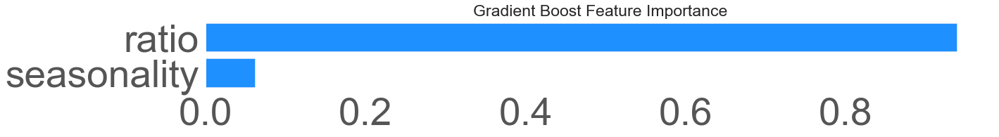

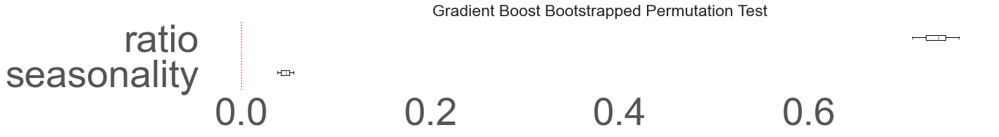

In [49]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality']]

nb_gb = NB_GB(dtp_df, 'dtp', alpha=9)
yhat_dtp_nb, yhat_dtp_gb = nb_gb.res()

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.feat_import(ax)
fig.tight_layout()
# fig.savefig('../images/dtp_feat_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.perm_import(ax)
fig.tight_layout()
# fig.savefig('../images/dtp_perm_imp.png')

#### use model and fake data point to get a predictions

In [50]:
yhat_dtp_nb

def undo_nb(coef, xval, alpha=1):
    e = (np.e**coef[0])*(np.e**(coef[1]*xval[0]))*(np.e**(coef[1]*xval[1]))
    y = (1/alpha)*(e/(1-e))
    return e
undo_nb([-8.9836, 0.1108, 0.0231], [95, 4]), undo_nb([-8.9836, 0.1108, 0.0231], [105, 12])

(7.283416124375302, 53.5170342274912)

### DTP QUICK

\\
dtp_\text{quick} = e^{1.3739} = 3.95

9.005005005005005
const      4.030464
lhs_x      0.029859
rhs_x      0.276640
lhs_xsq   -0.010043
rhs_xsq   -0.123110
dtype: float64 0.005837470570121406
nb mae cv results: [1.4728918277596714, 1.4707105522605304, 1.487800655726322, 1.447949675281772, 1.477275801782159]
nb rmse cv results: [1.8367451909230703, 1.8394585391174807, 1.850240813504197, 1.8104658969201792, 1.8531732196671031]
mean nb mae cv: 1.471325702562091
mean nb rmse cv: 1.8380167320264058
(1.471325702562091, 1.8380167320264058)
gb cv mae results: [-1.49187843 -1.48156613 -1.44324882 -1.45785812 -1.50502137]
gb cv rmse results: [-1.86721936 -1.85128785 -1.81251074 -1.83440939 -1.86556093]
mean gb mae cv: -1.4759145745788298
mean gb rmse cv: -1.846197653033111
(-1.4759145745788298, -1.846197653033111)
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                 8468
Model:                            GLM   Df Residuals:           

No handles with labels found to put in legend.


NB: The mean absolute error (MAE) on test set: 1.4793
NB: The root mean squared error (RMSE) on test set: 1.8423
GB: The mean absolute error (MAE) on test set: 1.4792
GB: The root mean squared error (RMSE) on test set: 1.8423
MEAN: The mean absolute error (MAE) on test set: 1.4856
MEAN: The root mean squared error (RMSE) on test set: 1.8459
MEDIAN: The mean absolute error (MAE) on test set: 1.4785
MEDIAN: The root mean squared error (RMSE) on test set: 1.8468
(4960     3.728966
10270    4.004997
2452     4.004997
2956     3.728966
5277     3.728966
           ...   
9956     4.004997
2615     4.004997
323      4.004997
9976     4.004997
1097     4.004997
Length: 2117, dtype: float64, array([3.73042361, 4.00464067, 4.00464067, ..., 4.00464067, 4.00464067,
       4.00464067]))


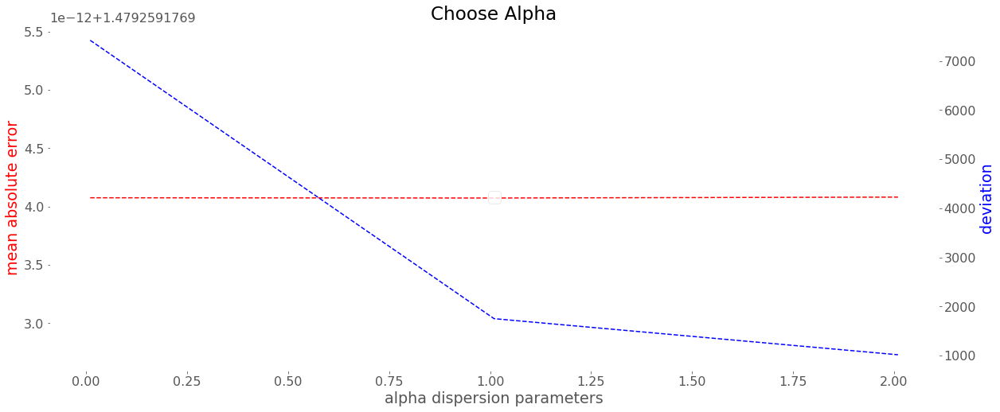

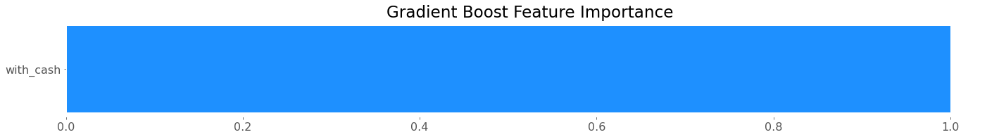

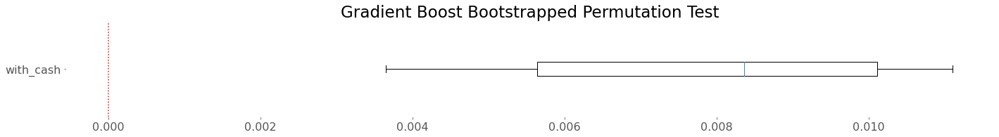

In [26]:
Q = pd.read_csv('../data/quick.csv')

b = rsq_best_b(Q, 1, 12, n=1000)[1]
print(b)
Q['seasonality'] = broken_stick_feature(b, Q)
Q['ratio'] = Q.ratio*100


# dtp_df = Q[['dtp']]#, 'ratio', 'with_cash']] # NB model
dtp_df = Q[['dtp', 'with_cash']] # GB model

# nb_gb = NB_GB(dtp_df, 'dtp', alpha=1) # Poisson NB model
nb_gb = NB_GB(dtp_df, 'dtp', alpha=1.01) # NB NB model
print(nb_gb.cv_nb())
print(nb_gb.cv_gb())
print(nb_gb.res())

fig, ax = plt.subplots()
nb_gb.choose_alpha(ax)
# fig.savefig('../images/quick_alpha_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.feat_import(ax)
fig.tight_layout()
# fig.savefig('../images/quick_feat_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.perm_import(ax)
fig.tight_layout()
# fig.savefig('../images/quick_perm_imp.png')

### DTP SLOW

\\
e^{X\beta} = e^{-2.1701}e^{0.0477\text(ratio)}e^{0.0197\text{(seasonal)}}e^{-0.1616(\text{cash buyer})}
\\
\\
dtp_{slow} = \left (1/\alpha  \right )ln(\left (1-\alpha  \right )e^{X\beta})
\\
\\
\\
e^{X\beta} = e^{-2.1701}e^{0.0477\text(95)}e^{0.0197\text{(14.99)}}e^{-0.1616(\text{0})}
\\
\\
dtp_{slow} = \left (1/0.001  \right )ln(1 - 0.001e^{X\beta}) = 14.35
\\
\\
\text{Overpriced in October, non-cash buyer:}
\\
\\
dtp_\text{slow} = e^{-2.1701}e^{0.0477(1.05)}e^{0.0197(12)}e^{-0.1616(0)} = 21.6 \text{ days}

In [158]:
# figure out why alpah = 1.01 shows up as 0.001 in the inverse link

def neg_bin_pred(coef_list, xvals, a=1.01):
    exb = 1
    for c, x in zip(coef_list, xvals):
        exb *= np.e**(c*x)
    return -(1/a)*np.log(1-a*exb)
    
neg_bin_pred([-2.1701, 0.0477, 0.0197, -0.1616], [1, 95, 14.9, 0], a=.001)  

# def pois_pred(coef_list, xvals):
#     exb = 1
#     for c, x in zip(coef_list, xvals):
#         exb *= np.e**(c*x)
#     return exb
# pois_pred([-2.1701, 0.0477, 0.0197, -0.1616], [1, 105, 37.12, 0])    


14.326120922134756

In [58]:
np.array([5,6,7])*np.array([1,.5, 0])

array([5., 3., 0.])

In [37]:
import numpy as np
(np.e**(-2.1701))*(np.e**(.0477*95))*(np.e**(.0197*4))*(np.e**(-.1616*0))

(np.e**(-2.1701))*(np.e**(.0477*105))*(np.e**(.0197*12))*(np.e**(-.1616*0))

21.645552368098514

9.434434434434435
const      47.950208
lhs_x      -7.850512
rhs_x     -10.250269
lhs_xsq     1.017936
rhs_xsq     5.127649
dtype: float64 0.042156634193036724
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                 8405
Model:                            GLM   Df Residuals:                     8401
Model Family:        NegativeBinomial   Df Model:                            3
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -39324.
Date:                Mon, 19 Apr 2021   Deviance:                       3687.3
Time:                        17:03:25   Pearson chi2:                 4.50e+03
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>

No handles with labels found to put in legend.


NB: The mean absolute error (MAE) on test set: 22.4555
NB: The root mean squared error (RMSE) on test set: 30.7873
GB: The mean absolute error (MAE) on test set: 21.6153
GB: The root mean squared error (RMSE) on test set: 29.8533
MEAN: The mean absolute error (MAE) on test set: 26.2501
MEAN: The root mean squared error (RMSE) on test set: 34.2093
MEDIAN: The mean absolute error (MAE) on test set: 24.2826
MEDIAN: The root mean squared error (RMSE) on test set: 36.1168
(8985     52.217015
565      48.465556
5173     27.149922
3884     34.085866
7823     45.320376
           ...    
9732     38.515266
6864     26.806364
2613     32.392207
10035    34.898116
9047     69.234693
Length: 2102, dtype: float64, array([54.0031866 , 50.18013998, 24.83428084, ..., 26.65518788,
       31.14206998, 55.87626015]))


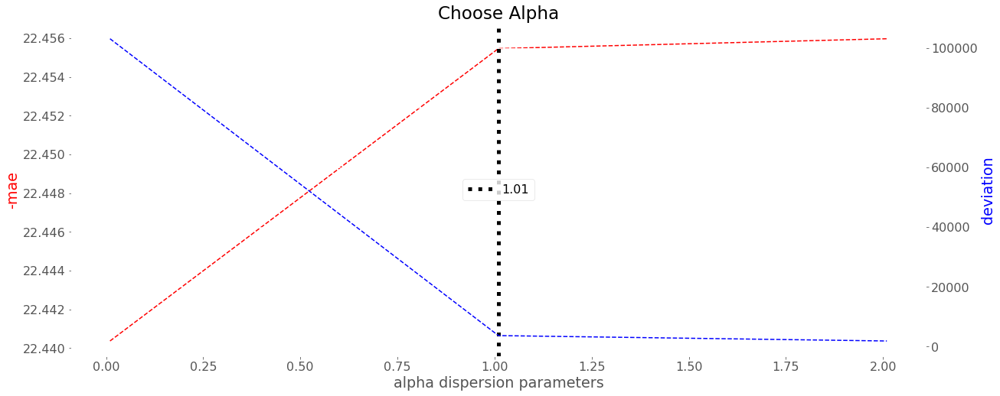

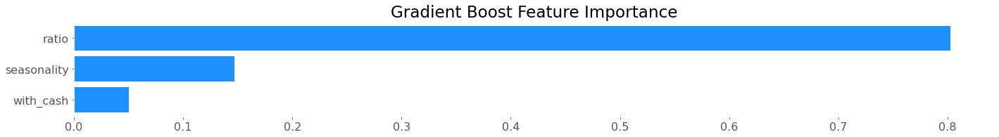

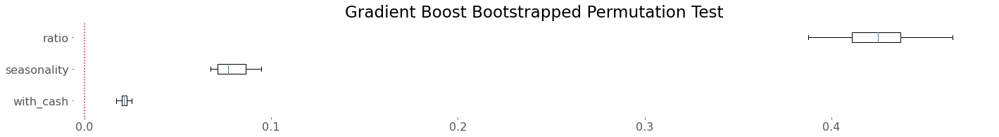

In [28]:
S = pd.read_csv('../data/slow.csv')

b = rsq_best_b(S, 1, 12, n=1000)[1]
print(b)
S['seasonality'] = broken_stick_feature(b, S)

S['ratio'] = S.ratio*100

dtp_df = S[['dtp', 'ratio', 'seasonality', 'with_cash']] # # NB model
# dtp_df = S[['dtp', 'ratio', 'seasonality', 'with_cash']] # GB model

nb_gb = NB_GB(dtp_df, 'dtp', alpha=1.01) # this looks like the best alpha, but still VERY overdispersed
# print(nb_gb.cv_nb())
# print(nb_gb.cv_gb())
print(nb_gb.res())

fig, ax = plt.subplots()
nb_gb.choose_alpha(ax)
# ax.set_xlim(.8,1.2)
ax.axvline(x=1.01, linestyle=':', color='k', linewidth=5, label='1.01')
ax.set_ylabel('-mae')
ax.legend(loc='center')
# fig.savefig('../images/slow_alpha_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.feat_import(ax)
fig.tight_layout()
# fig.savefig('../images/slow_feat_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.perm_import(ax)
fig.tight_layout()
# fig.savefig('../images/slow_perm_imp.png')


#### use model and fake data point to get a predictions

In [38]:
def undo_nb(coef, xval, alpha=1):
    e = (np.e**coef[0])*(np.e**(coef[1]*xval[0]))*(np.e**(coef[1]*xval[1]))
    y = (1/alpha)*(e/(1-e))
    return e
undo_nb([-1.4814, 0.0458, 0.0129], [95, 4]), undo_nb([-8.8942, 0.1109, 0.0184], [105, 12])

(21.174550236381975, 59.210565662850485)

In [ ]:
S = pd.read_csv('../data/slow.csv')
S['broken_stick'] = [br_stick(x, 5) for x in S.pcd_month]
S['seasonality'] = S.broken_stick
S['ratio'] = S.ratio*100
dtp_df = S[['dtp', 'ratio', 'seasonality', 'with_cash']]

H = pd.read_csv('../data/holdout.csv')
H['broken_stick'] = [br_stick(x, 5) for x in S.pcd_month]
H['seasonality'] = H.broken_stick
H['ratio'] = H.ratio*100
dtp_df = S[['dtp', 'ratio', 'seasonality', 'with_cash']]



## MODEL CHOICES

### FANCY

#### get pQ, pS + classification holdout scores

In [43]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
df = T[['quick', 'ratio', 'with_cash', 'seasonality']]

H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
ho = H[['quick', 'ratio', 'with_cash', 'seasonality']]


err, classhat, pQ  = LogMod(df).holdout(ho)
pS = 1-pQ

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
Optimization terminated successfully.
         Current function value: 0.468122
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:                  quick   No. Observations:                21092
Model:                          Logit   Df Residuals:                    21088
Method:                           MLE   Df Model:                            3
Date:                Tue, 20 Apr 2021   Pseudo R-squ.:                  0.3239
Time:                        08:57:32   Log-Likelihood:                -9873.6
converged:                       True   LL-Null:                       -14603.
Covariance Type:            nonrobust   LLR p-value:               

#### get Q and S predictions + quick and slow model holdout scores

In [44]:
# quick
Q = pd.read_csv('../data/quick.csv')
Q = pd.read_csv('../data/quick.csv')

b = rsq_best_b(Q, 1, 12, n=1000)[1]
print(b)
Q['seasonality'] = broken_stick_feature(b, Q)

Q['ratio'] = Q.ratio*100
Q['ratio'] = Q.ratio*100
dtp_df = Q[['dtp', 'with_cash']]

H = pd.read_csv('../data/holdout.csv')
H['seasonality'] =  broken_stick_feature(b, H)
H['ratio'] = H.ratio*100
dtpH_df = H[['dtp','with_cash']]

qnb_pred, qgb_pred = HoldOut(dtp_df, dtpH_df, 'dtp').res()
Q_nb_yhat = qnb_pred

# slow
S = pd.read_csv('../data/slow.csv')
b = rsq_best_b(S, 1, 12, n=1000)[1]
print(b)
S['seasonality'] = broken_stick_feature(b, S)
S['ratio'] = S.ratio*100
dtp_df_s = S[['dtp', 'ratio', 'seasonality']]

H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(b, H)
H['ratio'] = H.ratio*100
dtpH_df_s = H[['dtp','ratio', 'seasonality']]

snb_pred, sgb_pred = HoldOut(dtp_df_s, dtpH_df_s, 'dtp').res()
S_nb_yhat = snb_pred

9.005005005005005
const      4.030464
lhs_x      0.029859
rhs_x      0.276640
lhs_xsq   -0.010043
rhs_xsq   -0.123110
dtype: float64 0.005837470570121406
const      27.131803
lhs_x      -6.112361
rhs_x      -0.663071
lhs_xsq     0.806219
rhs_xsq     1.671543
dtype: float64 0.04824038672164532
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                10585
Model:                            GLM   Df Residuals:                    10583
Model Family:        NegativeBinomial   Df Model:                            1
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -39850.
Date:                Tue, 20 Apr 2021   Deviance:                       331.68
Time:                        08:58:28   Pearson chi2:                     251.
No. Iterations:                     5                                     

#### get DTC predicitons + DTC holdout scores

In [102]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtc_df = T[['dtc', 'with_cash']]#, 'ratio', 'seasonality']]

H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
dtcH_df = H[['dtc', 'with_cash']]#, 'ratio', 'seasonality']]

dtc_yhat_nb, dtc_yhat_gb = HoldOut(dtc_df, dtcH_df, 'dtc').res()
dtc_yhat=dtc_yhat_nb
len(dtc_yhat)

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtc   No. Observations:                21092
Model:                            GLM   Df Residuals:                    21090
Model Family:        NegativeBinomial   Df Model:                            1
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.2492e+05
Date:                Tue, 20 Apr 2021   Deviance:                       277.97
Time:                        10:22:33   Pearson chi2:                     282.
No. Iterations:                     4                                         
Covariance 

5284

#### fanciest model in the world holdout score

In [140]:
fancy_pred = pQ*Q_nb_yhat + pS*S_nb_yhat + dtc_yhat
y_test = H.dom

mae=mean_absolute_error(y_test,fancy_pred)
rmse=rmse_nb = np.sqrt(mean_squared_error(y_test, fancy_pred))
mae, rmse

# gradient boost version
fancy_pred = pQ*qgb_pred + pS* sgb_pred + dtc_yhat_gb
y_test = H.dom
mae=mean_absolute_error(y_test,fancy_pred)
rmse=rmse_nb = np.sqrt(mean_squared_error(y_test, fancy_pred))
mae, rmse

(17.8718019939294, 27.511749702344623)

In [105]:
pQ[0], Q_nb_yhat[0], pS[0], S_nb_yhat[0], dtc_yhat[0], pQ[0]*Q_nb_yhat[0]+pS[0]*S_nb_yhat[0]+dtc_yhat[0], H.dom[0], H.dtp[0], H.dtc[0]


S_nb_yhat[0]
# H[['dtp', 'ratio', 'seasonality', 'with_cash']].iloc[0]

22.716940781792403

### TRAINING: DTP+DTC

In [23]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality']]
dtc_df = T[['dtc', 'with_cash']]

H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
dtpH_df = H[['dtp', 'ratio', 'seasonality']]
dtcH_df = H[['dtc', 'with_cash']]

ho_dtp = HoldOut(dtp_df, dtpH_df, 'dtp')
yhat_dtp_nb, yhat_dtp_gb = ho_dtp.res()

ho_dtc = HoldOut(dtc_df, dtcH_df, 'dtc')
yhat_dtc_nb, yhat_dtc_gb = ho_dtc.res()

print('NEGATIVE BINOM MAE, RSME:')
mae=mean_absolute_error(H.dom,yhat_dtp_nb+yhat_dtc_nb)
rmse=rmse_nb = np.sqrt(mean_squared_error(H.dom,yhat_dtp_nb+yhat_dtc_nb))
print(mae, rmse)

print('GRADIENT BOOST MAE, RSME:')
mae=mean_absolute_error(H.dom,yhat_dtp_gb+yhat_dtc_gb)
rmse=rmse_nb = np.sqrt(mean_squared_error(H.dom,yhat_dtp_gb+yhat_dtc_gb))
print(mae, rmse)

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                21092
Model:                            GLM   Df Residuals:                    21089
Model Family:        NegativeBinomial   Df Model:                            2
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.0321e+05
Date:                Fri, 16 Apr 2021   Deviance:                       2374.7
Time:                        18:21:19   Pearson chi2:                 3.98e+03
No. Iterations:                     7                                         
Covariance 

### HOLDOUT: DTP + DTC

In [25]:
y_test = H.dom
yhat_dtp_dtc = yhat_dtc_nb + yhat_dtc_nb
mae = mean_absolute_error(y_test, yhat_dtp_dtc)
rmse = np.sqrt(mean_squared_error(y_test, yhat_dtp_dtc))
print("HOLDOUT_DTP_DTC: The mean absolute error (MAE) on test set: {:.4f}".format(mae))
print("HOLDOUT_DTP_DTC: The root mean squared error (RMSE) on test set: {:.4f}".format(rmse))

yhat_dtp_dtc = yhat_dtc_gb + yhat_dtc_gb
mae = mean_absolute_error(y_test, yhat_dtp_dtc)
rmse = np.sqrt(mean_squared_error(y_test, yhat_dtp_dtc))
print("HOLDOUT_DTP_DTC: The mean absolute error (MAE) on test set: {:.4f}".format(mae))
print("HOLDOUT_DTP_DTC: The root mean squared error (RMSE) on test set: {:.4f}".format(rmse))

HOLDOUT_DTP_DTC: The mean absolute error (MAE) on test set: 28.3311
HOLDOUT_DTP_DTC: The root mean squared error (RMSE) on test set: 34.8384
HOLDOUT_DTP_DTC: The mean absolute error (MAE) on test set: 28.3267
HOLDOUT_DTP_DTC: The root mean squared error (RMSE) on test set: 34.8315


### MEAN

In [26]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
 
H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
 
y_test = H.dom
yhat_mean = [T.dom.mean()]*H.shape[0]
mae = mean_absolute_error(y_test,yhat_mean)
rmse = np.sqrt(mean_squared_error(y_test, yhat_mean))
print("HOLDOUT_MEAN: The mean absolute error (MAE) on test set: {:.4f}".format(mae))
print("HOLDOUT_MEAN: The root mean squared error (RMSE) on test set: {:.4f}".format(rmse))

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
HOLDOUT_MEAN: The mean absolute error (MAE) on test set: 24.1659
HOLDOUT_MEAN: The root mean squared error (RMSE) on test set: 33.5099


### MEDIAN

In [27]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
 
H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
 
y_test = H.dom
yhat_median = [T.dom.median()]*H.shape[0]
mae = mean_absolute_error(y_test,yhat_median)
rmse = np.sqrt(mean_squared_error(y_test, yhat_median))
print("HOLDOUT_MEDIAN: The mean absolute error (MAE) on test set: {:.4f}".format(mae))
print("HOLDOUT_MEDIAN: The root mean squared error (RMSE) on test set: {:.4f}".format(rmse))

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
HOLDOUT_MEDIAN: The mean absolute error (MAE) on test set: 22.4432
HOLDOUT_MEDIAN: The root mean squared error (RMSE) on test set: 35.0361


### DOM

### DOM TRAIN

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dom   No. Observations:                16873
Model:                            GLM   Df Residuals:                    16869
Model Family:        NegativeBinomial   Df Model:                            3
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.0760e+05
Date:                Tue, 20 Apr 2021   Deviance:                       331.94
Time:                        11:28:48   Pearson chi2:                     405.
No. Iterations:                     5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025     

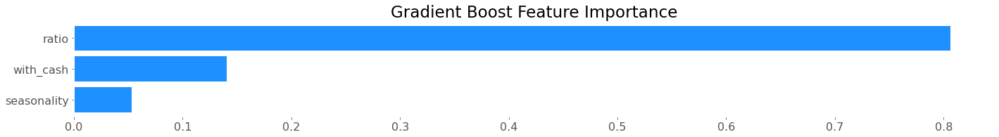

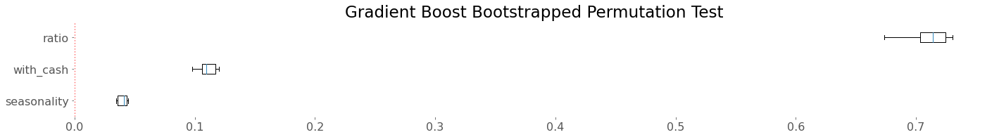

In [141]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dom_df = T[['dom', 'ratio', 'seasonality', 'with_cash']]

nb_gb = NB_GB(dom_df, 'dom', alpha=9)
nb_gb.res()

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.feat_import(ax)
fig.tight_layout()
fig.savefig('../images/dom_feat_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.perm_import(ax)
fig.tight_layout()
fig.savefig('../images/dom_perm_imp.png')

### DOM HOLDOUT

In [142]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dom_df = T[['dom', 'ratio', 'seasonality', 'with_cash']]
 
H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
domH_df = H[['dom', 'ratio', 'seasonality', 'with_cash']]
 
ho_dom = HoldOut(dom_df, domH_df, 'dom')
yhat_dom_nb, yhat_dom_gb = ho_dom.res()


const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dom   No. Observations:                21092
Model:                            GLM   Df Residuals:                    21088
Model Family:        NegativeBinomial   Df Model:                            3
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.3451e+05
Date:                Tue, 20 Apr 2021   Deviance:                       416.26
Time:                        11:37:37   Pearson chi2:                     505.
No. Iterations:                     5                                         
Covariance 

## FINAL MODEL: 
### 1) don't model DTC 
  - just say a month
  - 12 less for cash buyer (on avg in this model)  

### 2) DTP model for seasonal+pricing strategy

#### training model 5-fold CV

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                16873
Model:                            GLM   Df Residuals:                    16869
Model Family:        NegativeBinomial   Df Model:                            3
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -65284.
Date:                Tue, 20 Apr 2021   Deviance:                       15120.
Time:                        13:27:55   Pearson chi2:                 2.60e+04
No. Iterations:                     8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025     

No handles with labels found to put in legend.


NB: The mean absolute error (MAE) on test set: 18.2335
NB: The root mean squared error (RMSE) on test set: 41.4761
GB: The mean absolute error (MAE) on test set: 14.4162
GB: The root mean squared error (RMSE) on test set: 23.1614
MEAN: The mean absolute error (MAE) on test set: 22.0908
MEAN: The root mean squared error (RMSE) on test set: 30.5331
MEDIAN: The mean absolute error (MAE) on test set: 18.9042
MEDIAN: The root mean squared error (RMSE) on test set: 33.9454


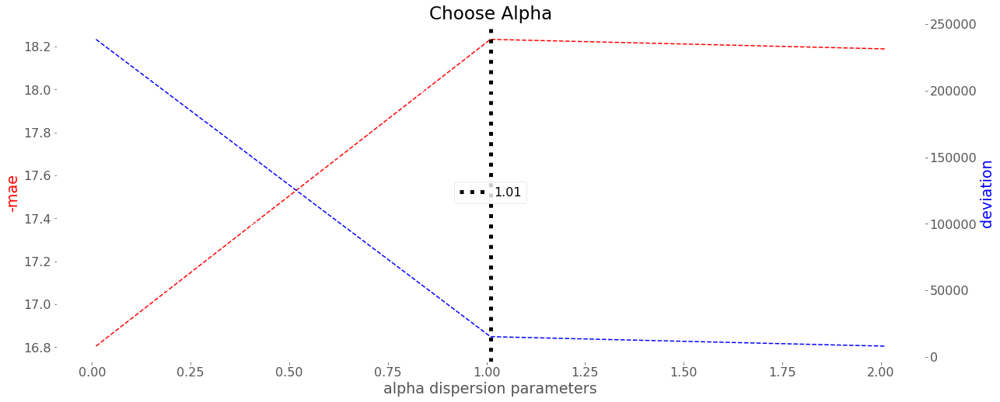

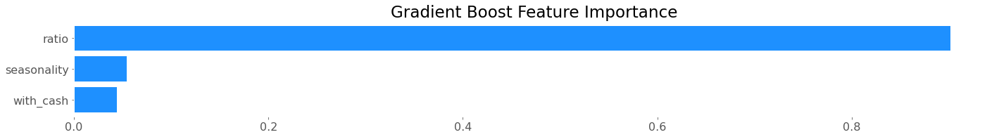

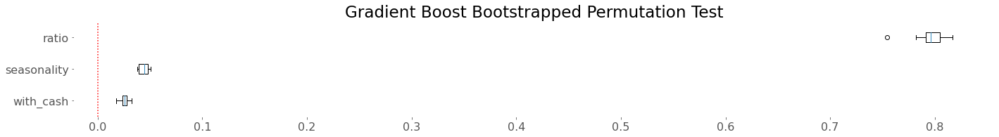

In [201]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality', 'with_cash']]
 

nb_gb = NB_GB(dtp_df, 'dtp', alpha=1.01)
yhat_dtp_nb, yhat_dtp_gb = nb_gb.res()

fig, ax = plt.subplots()
nb_gb.choose_alpha(ax)
# ax.set_xlim(.8,1.2)
ax.axvline(x=1.01, linestyle=':', color='k', linewidth=5, label='1.01')
ax.set_ylabel('-mae')
ax.legend(loc='center')
fig.savefig('../images/dtp_alpha_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.feat_import(ax)
fig.tight_layout()
fig.savefig('../images/dtp_feat_imp.png')

fig, ax = plt.subplots(figsize=(20,3))
nb_gb.perm_import(ax)
fig.tight_layout()
fig.savefig('../images/dtp_perm_imp.png')

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023


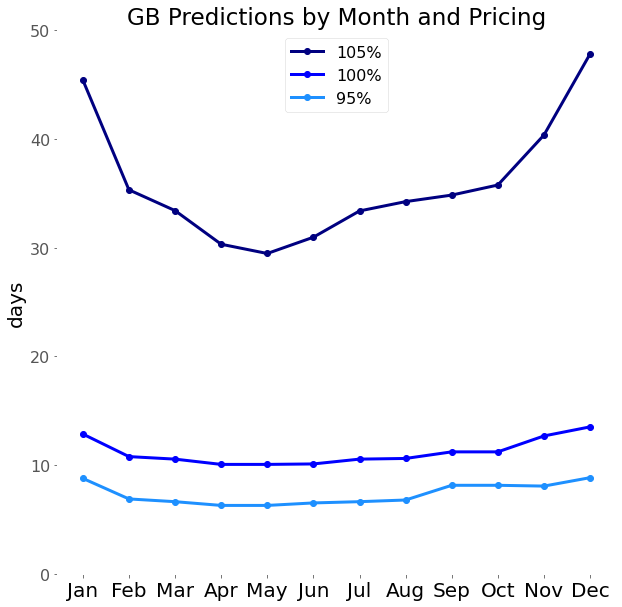

In [195]:
from sklearn.ensemble import GradientBoostingRegressor

T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality', 'with_cash', 'pcd_month']]

seasonality = dtp_df[['pcd_month', 'seasonality']].groupby('pcd_month').mean()
seasonality

dtp_df.pop('pcd_month')
y =  dtp_df.pop('dtp')
X =  dtp_df
Xtest = np.array([95, 14.9, 0]).reshape(1,-1)

params={'n_estimators': 500,
          'max_depth': 4,
          'min_samples_split': 5,
          'learning_rate': 0.01,
          'loss': 'ls'}

gb = GradientBoostingRegressor(**params).fit(X, y)

gbpred95 = [gb.predict(np.array([95, s, 0]).reshape(1,-1)) for s in seasonality.values]
gbpred100 = [gb.predict(np.array([100, s, 0]).reshape(1,-1)) for s in seasonality.values]
gbpred105 = [gb.predict(np.array([105, s, 0]).reshape(1,-1)) for s in seasonality.values]

fig, ax = plt.subplots(figsize=(10,10))
ax.plot(seasonality.index, gbpred105, 
        color='navy', label='105%', 
        marker='o',linewidth=3)

ax.plot(seasonality.index, gbpred100, 
        color='blue', label='100%', 
        marker='o',linewidth=3)

ax.plot(seasonality.index, gbpred95, 
        color='dodgerblue', label='95%', 
        marker='o',linewidth=3)
ax.set_xticks(np.arange(1,13))
ax.set_xticklabels([ 'Jan',  'Feb',  'Mar',  'Apr',  'May',  'Jun', 'Jul',  'Aug',  'Sep',  'Oct',  'Nov',  'Dec'], 
                   color='k', fontsize=20)
ax.set_ylabel('days', color='k', fontsize=20)
ax.set_title('GB Predictions by Month and Pricing')
ax.set_ylim(0,50)
ax.legend(loc='upper center');
fig.savefig('../images/gb_pred_month_pricing_noncash.png')

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023


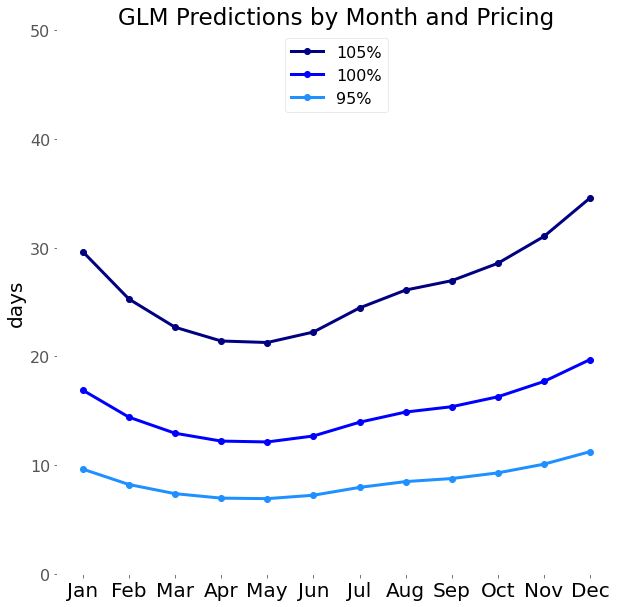

In [197]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality', 'with_cash', 'pcd_month']]

seasonality = dtp_df[['pcd_month', 'seasonality']].groupby('pcd_month').mean()
seasonality

def pred(xvals):
    coef_list = [-9.0754, 0.1124, 0.0222, -0.3245]
    exb = 1
    for c, x in zip(coef_list, xvals):
        exb *= np.e**(c*x)
    return exb

seasonality.values
pred95 = [pred([1, 95, s, 0]) for s in seasonality.values]
pred100 = [pred([1, 100, s, 0]) for s in seasonality.values]
pred105 = [pred([1, 105, s, 0]) for s in seasonality.values]

fig, ax = plt.subplots(figsize=(10,10))
ax.plot(seasonality.index, pred105, 
        color='navy', label='105%', 
        marker='o',linewidth=3)

ax.plot(seasonality.index, pred100, 
        color='blue', label='100%', 
        marker='o',linewidth=3)

ax.plot(seasonality.index, pred95, 
        color='dodgerblue', label='95%', 
        marker='o',linewidth=3)
ax.set_xticks(np.arange(1,13))
ax.set_xticklabels([ 'Jan',  'Feb',  'Mar',  'Apr',  'May',  'Jun', 'Jul',  'Aug',  'Sep',  'Oct',  'Nov',  'Dec'], 
                   color='k', fontsize=20)
ax.set_ylabel('days', color='k', fontsize=20)
ax.set_title('GLM Predictions by Month and Pricing')
ax.set_ylim(0,50)
ax.legend(loc='upper center');
fig.savefig('../images/glm_pred_month_pricing_noncash.png')

#### grid search for best params

In [31]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality']]

best_params={'n_estimators': 500,
          'max_depth': 4,
          'min_samples_split': 5,
          'learning_rate': 0.01,
          'loss': 'ls'}

nb_gb_best = NB_GB(dtp_df, 'dtp', alpha=9, params=best_params)
nb_gb_best.res()
yhat_dtp_nb, yhat_dtp_gb = nb_gb_best.res()


const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                16873
Model:                            GLM   Df Residuals:                    16870
Model Family:        NegativeBinomial   Df Model:                            2
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -82571.
Date:                Fri, 16 Apr 2021   Deviance:                       1896.7
Time:                        18:29:36   Pearson chi2:                 3.18e+03
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025     

#### Training for DTP + k days

In [202]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
df = T[['dtp', 'ratio', 'seasonality', 'with_cash', 'dom']]
 
# yhat_dtp_nb, yhat_dtp_gb = ho_dtp.res()
y = df.pop('dtp')
X = df
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)
y_test_dom = X_test.pop('dom')
y_train_dom = X_train.pop('dom')
 
gb_dtp = GradientBoostingRegressor().fit(X_train,y_train)   
yhat = gb_dtp.predict(X_test)

maes = []
rmses = []

for m in np.arange(30):
    yhat_mo = yhat + m
    mae = mean_absolute_error(y_test_dom, yhat_mo)
    rmse = np.sqrt(mean_squared_error(y_test_dom, yhat_mo))
    maes.append(mae)
    rmses.append(rmse)
maes[np.array(maes).argmin()], rmses[np.array(rmses).argmin()], np.array(maes).argmin(), np.array(rmses).argmin()

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023


(17.39027569109068, 26.108414312420216, 29, 29)

#### HOLDOUT: DTP + 29

const      23.789488
lhs_x      -6.434652
rhs_x       0.257893
lhs_xsq     1.144749
rhs_xsq     0.568135
dtype: float64 0.0436716100082023
const      22.026693
lhs_x      -5.410839
rhs_x       0.864586
lhs_xsq     1.055461
rhs_xsq     0.645314
dtype: float64 0.0489038019884146
                 Generalized Linear Model Regression Results                  
Dep. Variable:                    dtp   No. Observations:                21092
Model:                            GLM   Df Residuals:                    21088
Model Family:        NegativeBinomial   Df Model:                            3
Link Function:                    log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.0320e+05
Date:                Tue, 20 Apr 2021   Deviance:                       2345.4
Time:                        13:28:22   Pearson chi2:                 4.01e+03
No. Iterations:                     7                                         
Covariance 

(17.595037135962674, 27.072871760763185)

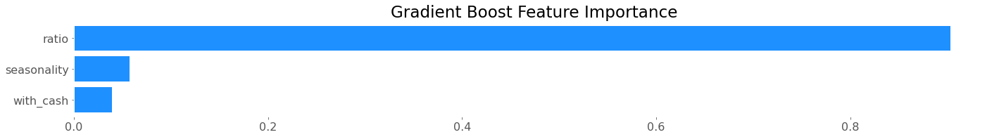

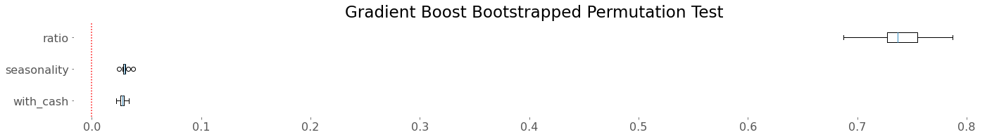

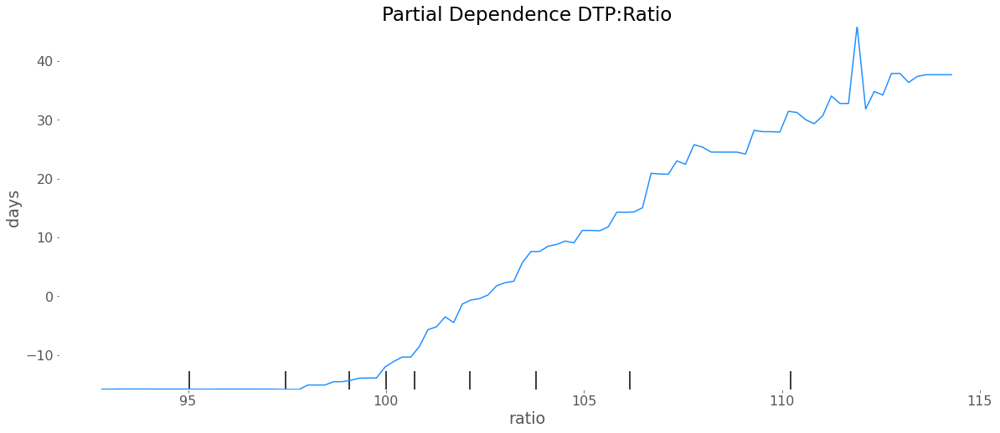

In [203]:
T = pd.read_csv('../data/train.csv')
T['seasonality'] = broken_stick_feature(7.44, T)
T['ratio'] = T.ratio*100
dtp_df = T[['dtp', 'ratio', 'seasonality', 'with_cash']]
 

H = pd.read_csv('../data/holdout.csv')
H['seasonality'] = broken_stick_feature(7.44, H)
H['ratio'] = H.ratio*100
dtpH_df = H[['dtp', 'ratio', 'seasonality', 'with_cash']]

best_params={'n_estimators': 500,
          'max_depth': 4,
          'min_samples_split': 5,
          'learning_rate': 0.01,
          'loss': 'ls'}

ho_dtp = HoldOut(dtp_df, dtpH_df, 'dtp', params=best_params)
yhat_dtp_nb, yhat_dtp_gb = ho_dtp.res()

fig, ax = plt.subplots(figsize=(20,3))
ho_dtp.feat_import(ax)
fig.tight_layout()
fig.savefig('../images/dtp_feat_imp_all_train.png')

fig, ax = plt.subplots(figsize=(20,3))
ho_dtp.perm_import(ax)
fig.tight_layout()
fig.savefig('../images/dtp_perm_imp_all_train.png')

ho_dtp.part_dep()
plt.title('Partial Dependence DTP:Ratio')
plt.xlabel('ratio')
plt.ylabel('days')
plt.savefig('../images/part_dep_ratio.png')

yhat_mo = yhat_dtp_gb + 29
mae = mean_absolute_error(H.dom, yhat_mo)
rmse = np.sqrt(mean_squared_error(H.dom, yhat_mo))
mae, rmse

### ERRORS DTP + 29

In [204]:
by_week = np.arange(25)*7
resids = pd.Series(yhat - y_test) #postive values are over-predictions
sorted_resids = resids.sort_values()
percents = []
for k in by_week:
    pct = (1 -((sorted_resids<-k).mean() + (sorted_resids>k).mean()))*100
    percents.append(pct)


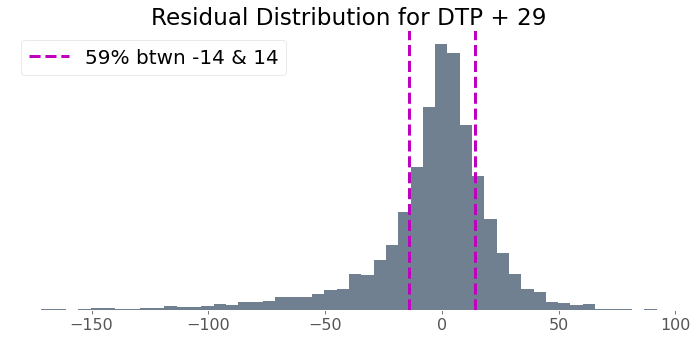

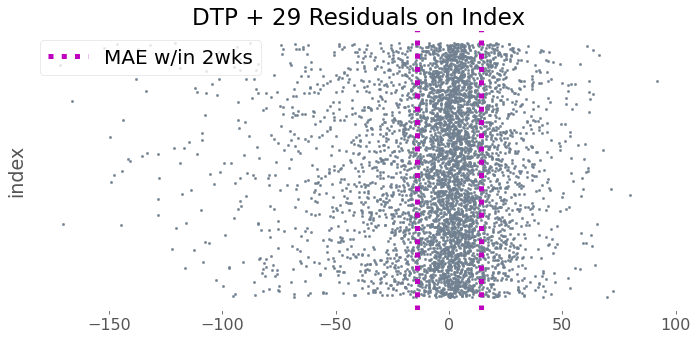

In [205]:
ytest = H.dom
yhat = yhat_dtp_gb + 29 # from DTP holdout results
k = 14
resids = pd.Series(yhat - ytest) #postive values are over-predictions
sorted_resids = resids.sort_values()
pct = (1 -((sorted_resids<-k).mean() + (sorted_resids>k).mean()))*100
l,h = -k, k

fig, ax = plt.subplots(figsize=(10,5))
ax.hist(resids, bins=50, color='slategrey')
ax.set_title('Residual Distribution for DTP + 29')
ax.axvline(x=l, label=f'{pct:2.0f}% btwn {l:2.0f} & {h:2.0f}', 
           linestyle='--', linewidth=3, color='m');
ax.axvline(x=h, linestyle='--', linewidth=3, color='m')
ax.set_yticks([])
ax.legend(fontsize=20)
fig.tight_layout();
fig.savefig('../images/29_resid_hist.png')

fig, ax = plt.subplots(figsize=(10,5))
ax.scatter(resids, resids.index, color='slategrey', s=5)
ax.set_title('DTP + 29 Residuals on Index')
ax.axvline(x=k, label='MAE w/in 2wks', linestyle=':', linewidth=5, color='m');
ax.axvline(x=-k, linestyle=':', linewidth=5, color='m')
ax.set_yticks([])
ax.set_ylabel('index')
ax.legend(loc='upper left', fontsize=20)
fig.tight_layout();
fig.savefig('../images/29_resid_scatter.png')

weeks = np.arange(180)
resids = pd.Series(yhat - ytest) #postive values are over-predictions
sorted_resids = resids.sort_values()
percents = []
for k in weeks:
    pct = (1 -((sorted_resids<-k).mean() + (sorted_resids>k).mean()))*100
    percents.append(pct)

### ERRORS DTP

(0.14894019682059045, 0.14780469341408023)

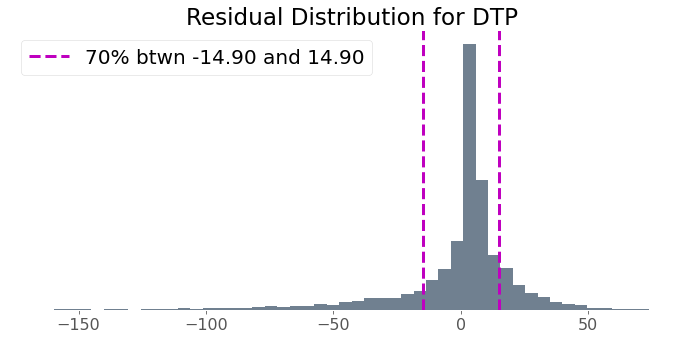

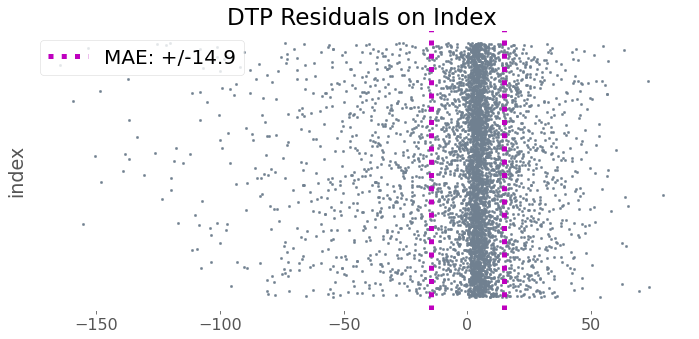

In [206]:
ytest = H.dtp
yhat = yhat_dtp_gb # from DTP holdout results

resids = pd.Series(yhat - ytest) #postive values are over-predictions
sorted_resids = resids.sort_values()
pct = (1 -((sorted_resids<-14.9).mean() + (sorted_resids>14.9).mean()))*100
l,h = -14.9, 14.9

fig, ax = plt.subplots(figsize=(10,5))
ax.hist(resids, bins=50, color='slategrey')
ax.set_title('Residual Distribution for DTP')
ax.axvline(x=l, label=f'{pct:2.0f}% btwn {l:2.2f} and {h:2.2f}', 
           linestyle='--', linewidth=3, color='m');
ax.axvline(x=h, linestyle='--', linewidth=3, color='m')
ax.set_yticks([])
ax.legend(fontsize=20)
fig.tight_layout();
fig.savefig('../images/resid_hist.png')

fig, ax = plt.subplots(figsize=(10,5))
ax.scatter(resids, resids.index, color='slategrey', s=5)
ax.set_title('DTP Residuals on Index')
ax.axvline(x=14.9, label='MAE: +/-14.9', linestyle=':', linewidth=5, color='m');
ax.axvline(x=-14.9, linestyle=':', linewidth=5, color='m')
ax.set_yticks([])
ax.set_ylabel('index')
ax.legend(loc='upper left', fontsize=20)
fig.tight_layout();
fig.savefig('../images/resid_scatter.png')

sorted_resids = resids.sort_values()
pct = 1 -((sorted_resids<-14.9).mean() + (sorted_resids>14.9).mean())
(sorted_resids<-14.9).mean(), (sorted_resids>14.9).mean()

## ERRORS DOM

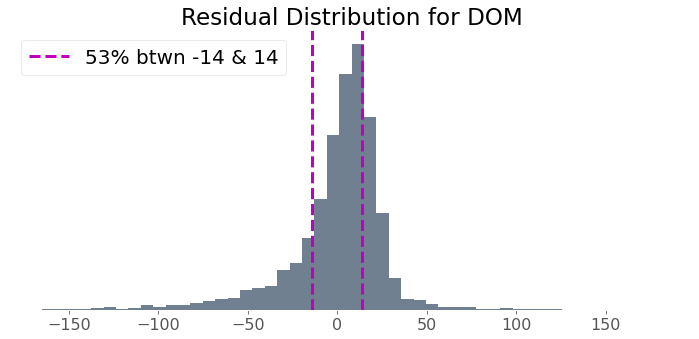

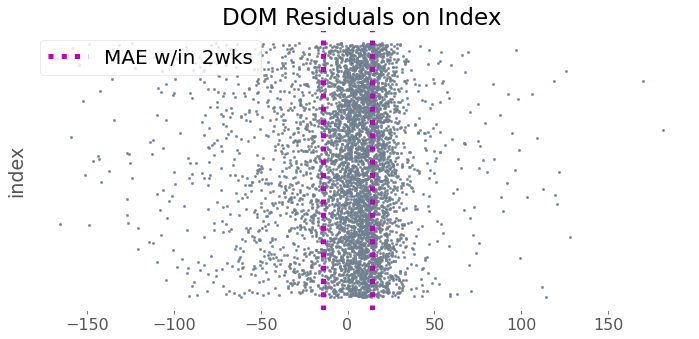

In [207]:
ytest = H.dom
yhat = yhat_dom_nb
k = 14
resids = pd.Series(yhat - ytest) #postive values are over-predictions
sorted_resids = resids.sort_values()
pct = (1 -((sorted_resids<-k).mean() + (sorted_resids>k).mean()))*100
l,h = -k, k

fig, ax = plt.subplots(figsize=(10,5))
ax.hist(resids, bins=50, color='slategrey')
ax.set_title('Residual Distribution for DOM')
ax.axvline(x=l, label=f'{pct:2.0f}% btwn {l:2.0f} & {h:2.0f}', 
           linestyle='--', linewidth=3, color='m');
ax.axvline(x=h, linestyle='--', linewidth=3, color='m')
ax.set_yticks([])
ax.legend(loc = 'upper left', fontsize=20)
fig.tight_layout();
fig.savefig('../images/dom_resid_hist.png')

fig, ax = plt.subplots(figsize=(10,5))
ax.scatter(resids, resids.index, color='slategrey', s=5)
ax.set_title('DOM Residuals on Index')
ax.axvline(x=k, label='MAE w/in 2wks', linestyle=':', linewidth=5, color='m');
ax.axvline(x=-k, linestyle=':', linewidth=5, color='m')
ax.set_yticks([])
ax.set_ylabel('index')
ax.legend(loc='upper left', fontsize=20)
fig.tight_layout();
fig.savefig('../images/dom_resid_scatter.png')

weeks = np.arange(180)
resids = pd.Series(yhat - ytest) #postive values are over-predictions
sorted_resids = resids.sort_values()
perc = []
for k in weeks:
    pct = (1 -((sorted_resids<-k).mean() + (sorted_resids>k).mean()))*100
    perc.append(pct)

#### compare the % of residuals within X days 

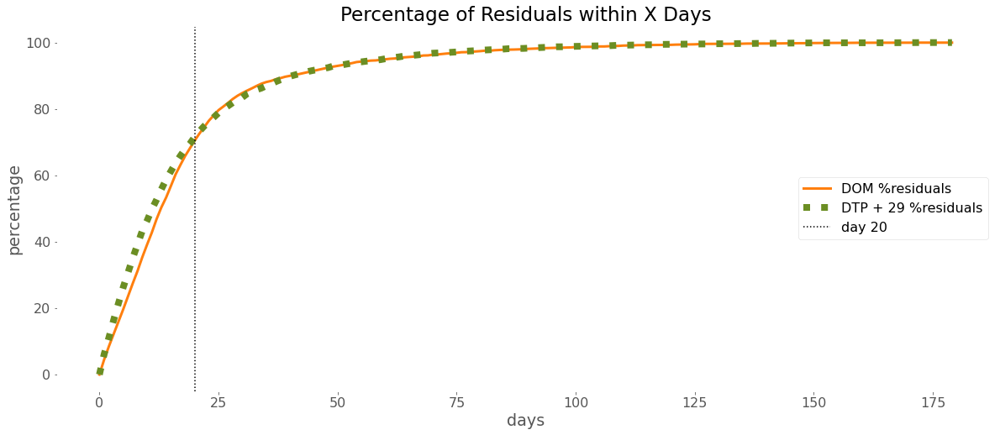

In [210]:
fig, ax = plt.subplots(figsize=(20,8))
ax.plot(weeks, perc, color='tab:orange', linestyle='-', linewidth=3, label='DOM %residuals')
ax.plot(weeks, percents, color='olivedrab', linestyle=':', linewidth=8, label='DTP + 29 %residuals')
ax.set_ylabel('percentage')
ax.set_xlabel('days')
ax.set_title('Percentage of Residuals within X Days')
ax.axvline(x=20, color='k', linestyle=':', label='day 20')
# ax.axvline(x=61, color='k', linestyle=':')
ax.legend(loc='center right');
fig.savefig('../images/resid_perc.png')

### look at where the switches are

In [74]:
for day, p1, p2 in zip(np.arange(180), perc, percents):
    print(day, p1, p2)

0 0.0 0.0
1 3.9364118092354294 5.999242997728993
2 8.080999242997722 11.071158213474641
3 12.093111279333835 15.934897804693415
4 15.91597274791825 20.93111279333838
5 19.66313398940197 25.62452687358062
6 23.391370174110527 30.14761544284632
7 27.25208175624527 34.80317940953823
8 31.074943224829678 38.9666919000757
9 35.25738077214231 42.77062831188494
10 39.2884178652536 45.74186222558667
11 42.90310370931113 48.95912187736563
12 46.801665404996214 51.85465556396669
13 50.113550340651024 54.901589704769115
14 53.72823618470856 57.66464799394397
15 57.09689629068887 60.200605601816804
16 60.333080999242995 62.71763815291445
17 63.417865253595764 65.14004542013626
18 66.16199848599547 66.88115064345193
19 68.26267978803938 68.79258137774413
20 70.47691143073429 70.59046177138532
21 73.03179409538228 72.27479182437547
22 74.65934897804694 73.61847085541257
23 76.57077971233915 74.98107494322484
24 78.23618470855412 76.47615442846329
25 79.40953822861468 77.80090840272521
26 80.54504163